# Project: Wrangle & Analyze WeRateDogs Twitter Data

## Contents
<ul>
<li><a href="#Introduction">Introduction</a></li>
<li><a href="#Importing Libraries">Importing Libraries</a></li>
<li><a href="#Gather Data">Gather Data</a></li>
<li><a href="#Assess Data">Assess Data</a></li>
<li><a href="#Clean Data">Clean Data</a></li>
<li><a href="#Insights and Visualization">Insights and Visualization</a></li>
<li><a href="#References">References</a></li>
</ul>

<a id='Introduction'></a>
## Introduction
The dataset that I will be wrangling, analyzing and visualizing is the tweet archive of Twitter user @dog_rates, also known as WeRateDogs. WeRateDogs is a Twitter account that rates people's dogs with a humorous comment about the dog. These ratings almost always have a denominator of 10. The numerators, though? Almost always greater than 10. 11/10, 12/10, 13/10, etc. Why? Because "they're good dogs Brent." WeRateDogs has over 4 million followers and has received international media coverage.

<a id='Importing Libraries'></a>
## Importing Libraries

In [412]:
import numpy as np
import pandas as pd
import os
import requests
import tweepy
import json
from numpy import median
from PIL import Image
from io import BytesIO
from timeit import default_timer as timer
from sqlalchemy import create_engine
import psycopg2 as pg2
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_style('darkgrid')
import warnings
warnings.filterwarnings('ignore')
# Viewing the dataframe without collapse (viewing all rows, columns with increased column width)
pd.set_option('display.max_rows', None) 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', -1) 


<a id='Gather Data'></a>
## Gather Data

> **`Gathering WeRateDogs twitter archive data in csv format`**

In [413]:
# loading csv data into a dataframe
wrd_archive = pd.read_csv('twitter-archive-enhanced.csv')
# Top five rows of dataframe
wrd_archive.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,None,None,None,None


> **`Gathering WeRateDogs tweet image predictions hosted on Udacity's servers (in tsv format)`**

In [414]:
# Downloading tsv file
url = 'https://d17h27t6h515a5.cloudfront.net/topher/2017/August/599fd2ad_image-predictions/image-predictions.tsv'
response = requests.get(url)
with open(url.split('/')[-1], mode='wb') as file:
    file.write(response.content)

In [415]:
# Loading downloaded tsv file into dataframe
wrd_image_prediction = pd.read_csv('image-predictions.tsv', sep = '\t')

In [416]:
# Top five rows of dataframe
wrd_image_prediction.head()

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,0.156665,True,Shetland_sheepdog,0.061428,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,0.074192,True,Rhodesian_ridgeback,0.072010,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,0.138584,True,bloodhound,0.116197,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,0.360687,True,miniature_pinscher,0.222752,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,0.243682,True,Doberman,0.154629,True


**`Gathering WeRateDogs twitter account additional data (retweet count and favorite ("like") count) through Twitter API`**

In [417]:
consumer_key = 'YOUR CONSUMER KEY'
consumer_secret = 'YOUR CONSUMER SECRET'
access_token = 'YOUR ACCESS TOKEN'
access_secret = 'YOUR ACCESS SECRET'

auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)

api = tweepy.API(auth, wait_on_rate_limit = True, wait_on_rate_limit_notify = True)

In [418]:
# Getting tweet details for a single tweet_id from the twitter archive
tweet = api.get_status(	892420643555336193, tweet_mode = 'extended' )
tweet

Status(_api=<tweepy.api.API object at 0x000002E11D403160>, _json={'created_at': 'Tue Aug 01 16:23:56 +0000 2017', 'id': 892420643555336193, 'id_str': '892420643555336193', 'full_text': "This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU", 'truncated': False, 'display_text_range': [0, 85], 'entities': {'hashtags': [], 'symbols': [], 'user_mentions': [], 'urls': [], 'media': [{'id': 892420639486877696, 'id_str': '892420639486877696', 'indices': [86, 109], 'media_url': 'http://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg', 'media_url_https': 'https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg', 'url': 'https://t.co/MgUWQ76dJU', 'display_url': 'pic.twitter.com/MgUWQ76dJU', 'expanded_url': 'https://twitter.com/dog_rates/status/892420643555336193/photo/1', 'type': 'photo', 'sizes': {'thumb': {'w': 150, 'h': 150, 'resize': 'crop'}, 'medium': {'w': 540, 'h': 528, 'resize': 'fit'}, 'small': {'w': 540, 'h': 528, 'resize': 'fit'}, 'large': {'w': 

In [419]:
# Viewing the json data
tweet._json

{'created_at': 'Tue Aug 01 16:23:56 +0000 2017',
 'id': 892420643555336193,
 'id_str': '892420643555336193',
 'full_text': "This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU",
 'truncated': False,
 'display_text_range': [0, 85],
 'entities': {'hashtags': [],
  'symbols': [],
  'user_mentions': [],
  'urls': [],
  'media': [{'id': 892420639486877696,
    'id_str': '892420639486877696',
    'indices': [86, 109],
    'media_url': 'http://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg',
    'media_url_https': 'https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg',
    'url': 'https://t.co/MgUWQ76dJU',
    'display_url': 'pic.twitter.com/MgUWQ76dJU',
    'expanded_url': 'https://twitter.com/dog_rates/status/892420643555336193/photo/1',
    'type': 'photo',
    'sizes': {'thumb': {'w': 150, 'h': 150, 'resize': 'crop'},
     'medium': {'w': 540, 'h': 528, 'resize': 'fit'},
     'small': {'w': 540, 'h': 528, 'resize': 'fit'},
     'large': {'w': 

In [420]:
# Verifying the presence of retweet count of tweet_id in json data
tweet._json['retweet_count']

7351

In [421]:
# Verifying the presence of favorite count of tweet_id in json data
tweet._json['favorite_count']

34991

In [33]:
# Creating file if it doesn't already exist
if not os.path.isfile(file_name):
    open(file_name, 'w').close()

> **`Below code will take approx. 30 minutes to run because Twitter API has a rate limit`**

In [34]:
# Query Twitter's API for JSON data for each tweet ID in the Twitter archive & writing twitter json data to tweet_json.txt file
tweet_id_errors = {}
count = 0
start = timer()
with open(file_name, mode = 'w') as file:
    for tweet_id in wrd_archive.tweet_id:
        try:
            tweet = api.get_status(tweet_id, tweet_mode='extended')
            file.write(json.dumps(tweet._json) + '\n')
            print(str(count) + '_' + str(tweet_id))
            count +=1
        except Exception as e:
            print(str(count) + '_' + str(tweet_id) + str(e))
            tweet_id_errors[str(count) + '_' + str(tweet_id)] = tweet._json
            count +=1
end = timer()
print('Elapsed Time:' + str(end-start))

0_892420643555336193
1_892177421306343426
2_891815181378084864
3_891689557279858688
4_891327558926688256
5_891087950875897856
6_890971913173991426
7_890729181411237888
8_890609185150312448
9_890240255349198849
10_890006608113172480
11_889880896479866881
12_889665388333682689
13_889638837579907072
14_889531135344209921
15_889278841981685760
16_888917238123831296
17_888804989199671297
18_888554962724278272
19_888202515573088257[{'code': 144, 'message': 'No status found with that ID.'}]
20_888078434458587136
21_887705289381826560
22_887517139158093824
23_887473957103951883
24_887343217045368832
25_887101392804085760
26_886983233522544640
27_886736880519319552
28_886680336477933568
29_886366144734445568
30_886267009285017600
31_886258384151887873
32_886054160059072513
33_885984800019947520
34_885528943205470208
35_885518971528720385
36_885311592912609280
37_885167619883638784
38_884925521741709313
39_884876753390489601
40_884562892145688576
41_884441805382717440
42_884247878851493888
43_88

326_833826103416520705
327_833732339549220864
328_833722901757046785
329_833479644947025920
330_833124694597443584
331_832998151111966721
332_832769181346996225
333_832757312314028032
334_832682457690300417
335_832645525019123713
336_832636094638288896
337_832397543355072512
338_832369877331693569
339_832273440279240704
340_832215909146226688
341_832215726631055365
342_832088576586297345
343_832040443403784192
344_832032802820481025
345_831939777352105988
346_831926988323639298
347_831911600680497154
348_831670449226514432
349_831650051525054464
350_831552930092285952
351_831322785565769729
352_831315979191906304
353_831309418084069378
354_831262627380748289
355_830956169170665475
356_830583320585068544
357_830173239259324417
358_830097400375152640
359_829878982036299777
360_829861396166877184
361_829501995190984704
362_829449946868879360
363_829374341691346946[{'code': 144, 'message': 'No status found with that ID.'}]
364_829141528400556032
365_829011960981237760
366_82880155108704256

672_789903600034189313
673_789628658055020548
674_789599242079838210
675_789530877013393408
676_789314372632018944
677_789280767834746880
678_789268448748703744
679_789137962068021249
680_788908386943430656
681_788765914992902144
682_788552643979468800
683_788412144018661376
684_788178268662984705
685_788150585577050112
686_788070120937619456
687_788039637453406209
688_787810552592695296
689_787717603741622272
690_787397959788929025
691_787322443945877504
692_787111942498508800
693_786963064373534720
694_786729988674449408
695_786709082849828864
696_786664955043049472
697_786595970293370880
698_786363235746385920
699_786286427768250368
700_786233965241827333
701_786051337297522688
702_786036967502913536
703_785927819176054784
704_785872687017132033
705_785639753186217984
706_785533386513321988
707_785515384317313025
708_785264754247995392
709_785170936622350336
710_784826020293709826
711_784517518371221505
712_784431430411685888
713_784183165795655680
714_784057939640352768
715_7838399

Rate limit reached. Sleeping for: 444


898_758854675097526272
899_758828659922702336
900_758740312047005698
901_758474966123810816
902_758467244762497024
903_758405701903519748
904_758355060040593408
905_758099635764359168
906_758041019896193024
907_757741869644341248
908_757729163776290825
909_757725642876129280
910_757611664640446465
911_757597904299253760
912_757596066325864448
913_757400162377592832
914_757393109802180609
915_757354760399941633
916_756998049151549440
917_756939218950160384
918_756651752796094464
919_756526248105566208
920_756303284449767430
921_756288534030475264
922_756275833623502848
923_755955933503782912
924_755206590534418437
925_755110668769038337
926_754874841593970688
927_754856583969079297
928_754747087846248448
929_754482103782404096
930_754449512966619136
931_754120377874386944
932_754011816964026368[{'code': 144, 'message': 'No status found with that ID.'}]
933_753655901052166144
934_753420520834629632
935_753398408988139520
936_753375668877008896
937_753298634498793472
938_75329448756952268

1242_711998809858043904
1243_711968124745228288
1244_711743778164514816
1245_711732680602345472
1246_711694788429553666
1247_711652651650457602
1248_711363825979756544
1249_711306686208872448
1250_711008018775851008
1251_710997087345876993
1252_710844581445812225
1253_710833117892898816
1254_710658690886586372
1255_710609963652087808
1256_710588934686908417
1257_710296729921429505
1258_710283270106132480
1259_710272297844797440
1260_710269109699739648
1261_710153181850935296
1262_710140971284037632
1263_710117014656950272
1264_709918798883774466
1265_709901256215666688
1266_709852847387627521
1267_709566166965075968
1268_709556954897764353
1269_709519240576036864
1270_709449600415961088
1271_709409458133323776
1272_709225125749587968
1273_709207347839836162
1274_709198395643068416
1275_709179584944730112
1276_709158332880297985
1277_709042156699303936
1278_708853462201716736
1279_708845821941387268
1280_708834316713893888
1281_708810915978854401
1282_708738143638450176
1283_70871108899

1584_687096057537363968
1585_686947101016735744
1586_686760001961103360
1587_686749460672679938
1588_686730991906516992
1589_686683045143953408
1590_686618349602762752
1591_686606069955735556
1592_686394059078897668
1593_686386521809772549
1594_686377065986265092
1595_686358356425093120
1596_686286779679375361
1597_686050296934563840
1598_686035780142297088
1599_686034024800862208
1600_686007916130873345
1601_686003207160610816
1602_685973236358713344
1603_685943807276412928
1604_685906723014619143
1605_685681090388975616
1606_685667379192414208
1607_685663452032069632
1608_685641971164143616
1609_685547936038666240
1610_685532292383666176
1611_685325112850124800
1612_685321586178670592
1613_685315239903100929
1614_685307451701334016
1615_685268753634967552
1616_685198997565345792
1617_685169283572338688
1618_684969860808454144
1619_684959798585110529
1620_684940049151070208
1621_684926975086034944
1622_684914660081053696
1623_684902183876321280
1624_684880619965411328
1625_68483098265

Rate limit reached. Sleeping for: 590


1798_677228873407442944
1799_677187300187611136
1800_676975532580409345
1801_676957860086095872
1802_676949632774234114
1803_676948236477857792
1804_676946864479084545
1805_676942428000112642
1806_676936541936185344
1807_676916996760600576
1808_676897532954456065
1809_676864501615042560
1810_676821958043033607
1811_676819651066732545
1812_676811746707918848
1813_676776431406465024
1814_676617503762681856
1815_676613908052996102
1816_676606785097199616
1817_676603393314578432
1818_676593408224403456
1819_676590572941893632
1820_676588346097852417
1821_676582956622721024
1822_676575501977128964
1823_676533798876651520
1824_676496375194980353
1825_676470639084101634
1826_676440007570247681
1827_676430933382295552
1828_676263575653122048
1829_676237365392908289
1830_676219687039057920
1831_676215927814406144
1832_676191832485810177
1833_676146341966438401
1834_676121918416756736
1835_676101918813499392
1836_676098748976615425
1837_676089483918516224
1838_675898130735476737
1839_67589155576

2140_670003130994700288
2141_669993076832759809
2142_669972011175813120
2143_669970042633789440
2144_669942763794931712
2145_669926384437997569
2146_669923323644657664
2147_669753178989142016
2148_669749430875258880
2149_669684865554620416
2150_669683899023405056
2151_669682095984410625
2152_669680153564442624
2153_669661792646373376
2154_669625907762618368
2155_669603084620980224
2156_669597912108789760
2157_669583744538451968
2158_669573570759163904
2159_669571471778410496
2160_669567591774625800
2161_669564461267722241
2162_669393256313184256
2163_669375718304980992
2164_669371483794317312
2165_669367896104181761
2166_669363888236994561
2167_669359674819481600
2168_669354382627049472
2169_669353438988365824
2170_669351434509529089
2171_669328503091937280
2172_669327207240699904
2173_669324657376567296
2174_669216679721873412
2175_669214165781868544
2176_669203728096960512
2177_669037058363662336
2178_669015743032369152
2179_669006782128353280
2180_669000397445533696
2181_66899491307

In [422]:
# Reading twitter json data from tweet_json.txt file by converting each json string into python dictionary
# and appending them to a list (row by row) and this list of dictionaries will eventually be converted to a pandas DataFrame 

df_list = []
with open('tweet_json.txt', mode = 'r') as file:
    for row in file.readlines():
        tweet_dict = json.loads(row)
        retweet_count = tweet_dict['retweet_count']
        favorite_count = tweet_dict['favorite_count']
        tweet_id = tweet_dict['id']
        df_list.append({'tweet_id': tweet_id, 
                        'retweet_count': retweet_count, 
                        'favorite_count': favorite_count})    

In [423]:
# Creating DataFrame from list of dictionaries
wrd_archive_add = pd.DataFrame(df_list, columns = ['tweet_id', 'retweet_count', 'favorite_count'])

In [424]:
# Top five rows of dataframe
wrd_archive_add.head()

,tweet_id,retweet_count,favorite_count
0,892420643555336193,7378,35054
1,892177421306343426,5497,30354
2,891815181378084864,3633,22823
3,891689557279858688,7548,38308
4,891327558926688256,8141,36591


<a id='Assess Data'></a>
## Assess Data

> **`Table/Dataframe 1: wrd_archive contains twitter archive data of WeRateDogs`**

In [425]:
# Viewing the dataframe
wrd_archive

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,None,None,None,None
5,891087950875897856,NaN,NaN,2017-07-29 00:08:17 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking. 13/10 (IG: tucker_marlo) #BarkWeek https://t.co/kQ04fDDRmh,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891087950875897856/photo/1,13,10,None,None,None,None,None
6,890971913173991426,NaN,NaN,2017-07-28 16:27:12 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Jax. He enjoys ice cream so much he gets nervous around it. 13/10 help Jax enjoy more things by clicking below\n\nhttps://t.co/Zr4hWfAs1H https://t.co/tVJBRMnhxl,NaN,NaN,NaN,"https://gofundme.com/ydvmve-surgery-for-jax,https://twitter.com/dog_rates/status/890971913173991426/photo/1",13,10,Jax,None,None,None,None
7,890729181411237888,NaN,NaN,2017-07-28 00:22:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",When you watch your owner call another dog a good boy but then they turn back to you and say you're a great boy. 13/10 https://t.co/v0nONBcwxq,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/890729181411237888/photo/1,https://twitter.com/dog_rates/status/890729181411237888/photo/1",13,10,None,None,None,None,None
8,890609185150312448,NaN,NaN,2017-07-27 16:25:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Zoey. She doesn't want to be one of the scary sharks. Just wants to be a snuggly pettable boatpet. 13/10 #BarkWeek https://t.co/9TwLuAGH0b,NaN,NaN,NaN,https://twitter.com/dog_rates/status/890609185150312448/photo/1,13,10,Zoey,None,None,None,None
9,89024025534

In [426]:
# Dimensions of dataframe
wrd_archive.shape

(2356, 17)

In [427]:
# Information regarding columns (indexes, name, datatypes and non-null values)
wrd_archive.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 

In [428]:
# Checking for missing values
wrd_archive.isnull().sum()

tweet_id                      0   
in_reply_to_status_id         2278
in_reply_to_user_id           2278
timestamp                     0   
source                        0   
text                          0   
retweeted_status_id           2175
retweeted_status_user_id      2175
retweeted_status_timestamp    2175
expanded_urls                 59  
rating_numerator              0   
rating_denominator            0   
name                          0   
doggo                         0   
floofer                       0   
pupper                        0   
puppo                         0   
dtype: int64

In [429]:
# Checking for duplicate values
sum(wrd_archive.duplicated())

0

In [430]:
# No of unique values in each column
wrd_archive.nunique()

tweet_id                      2356
in_reply_to_status_id         77  
in_reply_to_user_id           31  
timestamp                     2356
source                        4   
text                          2356
retweeted_status_id           181 
retweeted_status_user_id      25  
retweeted_status_timestamp    181 
expanded_urls                 2218
rating_numerator              40  
rating_denominator            18  
name                          957 
doggo                         2   
floofer                       2   
pupper                        2   
puppo                         2   
dtype: int64

In [431]:
# No of unique values in doggo,floofer,pupper,puppo columns

In [432]:
wrd_archive.doggo.unique()

array(['None', 'doggo'], dtype=object)

In [433]:
wrd_archive.floofer.unique()

array(['None', 'floofer'], dtype=object)

In [434]:
wrd_archive.pupper.unique()

array(['None', 'pupper'], dtype=object)

In [435]:
wrd_archive.puppo.unique()

array(['None', 'puppo'], dtype=object)

In [436]:
wrd_archive.doggo.value_counts()

None     2259
doggo    97  
Name: doggo, dtype: int64

In [437]:
wrd_archive.floofer.value_counts()

None       2346
floofer    10  
Name: floofer, dtype: int64

In [438]:
wrd_archive.pupper.value_counts()

None      2099
pupper    257 
Name: pupper, dtype: int64

In [439]:
wrd_archive.puppo.value_counts()

None     2326
puppo    30  
Name: puppo, dtype: int64

In [440]:
# No of unique values in name column
wrd_archive.name.value_counts() # found some incorrect names: all, my, not, a, an, the, by, such

None              745
a                 55 
Charlie           12 
Cooper            11 
Oliver            11 
Lucy              11 
Lola              10 
Penny             10 
Tucker            10 
Winston           9  
Bo                9  
Sadie             8  
the               8  
Daisy             7  
Bailey            7  
Toby              7  
Buddy             7  
an                7  
Stanley           6  
Dave              6  
Jax               6  
Scout             6  
Rusty             6  
Oscar             6  
Koda              6  
Leo               6  
Bella             6  
Jack              6  
Milo              6  
Oakley            5  
Phil              5  
Chester           5  
very              5  
Larry             5  
Finn              5  
Sammy             5  
Gus               5  
Bentley           5  
Alfie             5  
Louis             5  
Sunny             5  
George            5  
Clark             4  
Gerald            4  
Loki              4  
Chip      

In [441]:
# No of null(named as None) values in name column
wrd_archive.query('name == "None"').name.count()

745

In [442]:
# No of unique values in rating numerator column
wrd_archive.rating_numerator.value_counts()

12      558
11      464
10      461
13      351
9       158
8       102
7       55 
14      54 
5       37 
6       32 
3       19 
4       17 
1       9  
2       9  
420     2  
0       2  
15      2  
75      2  
80      1  
20      1  
24      1  
26      1  
44      1  
50      1  
60      1  
165     1  
84      1  
88      1  
144     1  
182     1  
143     1  
666     1  
960     1  
1776    1  
17      1  
27      1  
45      1  
99      1  
121     1  
204     1  
Name: rating_numerator, dtype: int64

In [443]:
# No of unique values in rating denominator column
wrd_archive.rating_denominator.value_counts()

10     2333
11     3   
50     3   
80     2   
20     2   
2      1   
16     1   
40     1   
70     1   
15     1   
90     1   
110    1   
120    1   
130    1   
150    1   
170    1   
7      1   
0      1   
Name: rating_denominator, dtype: int64

> **`Table/Dataframe 2: wrd_archive_add contains twitter api data (retweets and likes) of WeRateDogs`**

In [444]:
# Viewing the dataframe
wrd_archive_add

,tweet_id,retweet_count,favorite_count
0,892420643555336193,7378,35054
1,892177421306343426,5497,30354
2,891815181378084864,3633,22823
3,891689557279858688,7548,38308
4,891327558926688256,8141,36591
5,891087950875897856,2725,18447
6,890971913173991426,1765,10730
7,890729181411237888,16515,59002
8,890609185150312448,3780,25407
9,890240255349198849,6401,28981


In [445]:
# Dimensions of dataframe
wrd_archive_add.shape

(2331, 3)

In [446]:
# Information regarding columns (indexes, name, datatypes and non-null values)
wrd_archive_add.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2331 entries, 0 to 2330
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   tweet_id        2331 non-null   int64
 1   retweet_count   2331 non-null   int64
 2   favorite_count  2331 non-null   int64
dtypes: int64(3)
memory usage: 54.8 KB


In [447]:
# Checking for missing values
wrd_archive_add.isnull().sum()

tweet_id          0
retweet_count     0
favorite_count    0
dtype: int64

In [448]:
# Checking for duplicate values
sum(wrd_archive_add.duplicated())

0

> **`Table/Dataframe 3: wrd_image_prediction contains tweet image prediction data`**

In [449]:
# Viewing the dataframe
wrd_image_prediction

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,1.566650e-01,True,Shetland_sheepdog,6.142850e-02,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,7.419170e-02,True,Rhodesian_ridgeback,7.201000e-02,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,1.385840e-01,True,bloodhound,1.161970e-01,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,3.606870e-01,True,miniature_pinscher,2.227520e-01,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,2.436820e-01,True,Doberman,1.546290e-01,True
5,666050758794694657,https://pbs.twimg.com/media/CT5Jof1WUAEuVxN.jpg,1,Bernese_mountain_dog,0.651137,True,English_springer,2.637880e-01,True,Greater_Swiss_Mountain_dog,1.619920e-02,True
6,666051853826850816,https://pbs.twimg.com/media/CT5KoJ1WoAAJash.jpg,1,box_turtle,0.933012,False,mud_turtle,4.588540e-02,False,terrapin,1.788530e-02,False
7,666055525042405380,https://pbs.twimg.com/media/CT5N9tpXIAAifs1.jpg,1,chow,0.692517,True,Tibetan_mastiff,5.827940e-02,True,fur_coat,5.444860e-02,False
8,666057090499244032,https://pbs.twimg.com/media/CT5PY90WoAAQGLo.jpg,1,shopping_cart,0.962465,False,shopping_basket,1.459380e-02,False,golden_retriever,7.958960e-03,True
9,666058600524156928,https://pbs.twimg.com/media/CT5Qw94XAAA_2dP.jpg,1,miniature_poodle,0.201493,True,komondor,1.923050e-01,True,soft-coated_wheaten_terrier,8.208610e-02,True


In [450]:
# Dimensions of dataframe
wrd_image_prediction.shape

(2075, 12)

In [451]:
# Information regarding columns (indexes, name, datatypes and non-null values)
wrd_image_prediction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [452]:
# Checking for missing values
wrd_image_prediction.isnull().sum()

tweet_id    0
jpg_url     0
img_num     0
p1          0
p1_conf     0
p1_dog      0
p2          0
p2_conf     0
p2_dog      0
p3          0
p3_conf     0
p3_dog      0
dtype: int64

In [453]:
# Checking for duplicate values
sum(wrd_image_prediction.duplicated())

0

**Quality issues**

**`Dimension`** **:** **`Issue`**

**`Table 1: wrd_archive (twitter archive data of WeRateDogs)`**

1. **Completeness:** Missing values of dog stages and dog names **(can't clean)** 
2. **Accuracy:** Replace missing values named as None with NaN in name and dog stages columns
3. **Validity:** Erroneous datatypes of tweet id, it should be string not integer
4. **Accuracy:** Investigate name column for incorrect names as some of the dog names seemed inaccurate (all, my, not,                    a, an, the, by, such)
5. **Consistency:** Only those tweet ids who have image predictions in the image prediction table
6. **Accuracy:** Inaccurate values of rating denominator
7. **Accuracy:** Inaccurate values of rating numerator
8. **Validity:** Timestamp, retweeted_status_timestamp datatype is of string, it should be datetime
9. **Consistency:** We want original ratings so remove tweet ids which are retweets

**`Table 2: wrd_archive_add contains twitter api data (retweets and likes) of WeRateDogs`**

1. **Validity:** Erroneous datatypes of tweet id, it should be string not integer

**`Table 3: wrd_image_prediction contains tweet image prediction data`**

1. **Validity:** Erroneous datatypes of tweet id, it should be string not integer


**Tidiness issues**

**`Tidy Data: Each variable forms a column`**

1. Melt the columns doggo, floofer, pupper and puppo as these column headers are values instead of variable names, variable name is dog stage in the archive table (wrd_archive) 
2. Split text column of archive table into two separate columns (tweet_text and tweet_url) 

**`Tidy Data: Each type of observational unit forms a table`**

3. Merge the archive (wrd_archive), archive additional (wrd_archive_add) and image prediction (wrd_image_prediction) tables



<a id='Clean Data'></a>
## Clean Data

> **`Creating copies of all the three tables to perform cleaning tasks`**

In [454]:
wrd_archive_clean = wrd_archive.copy()
wrd_archive_add_clean = wrd_archive_add.copy()
wrd_image_prediction_clean = wrd_image_prediction.copy()

### Missing Data

> **`Dealing with missing values`**

#### Define
Replace missing values named as None with NaN in name and dog stages columns of wrd_archive_clean table.

#### Code

In [455]:
wrd_archive_clean.name.replace('None', np.nan, inplace = True)
wrd_archive_clean.doggo.replace('None', np.nan, inplace = True)
wrd_archive_clean.floofer.replace('None', np.nan, inplace = True)
wrd_archive_clean.pupper.replace('None', np.nan, inplace = True)
wrd_archive_clean.puppo.replace('None', np.nan, inplace = True)

#### Test

In [456]:
print(wrd_archive_clean.query('name == "None"').name.count())
print(wrd_archive_clean.query('doggo == "None"').doggo.count())
print(wrd_archive_clean.query('doggo == "None"').floofer.count())
print(wrd_archive_clean.query('doggo == "None"').pupper.count())
print(wrd_archive_clean.query('doggo == "None"').puppo.count())

0
0
0
0
0


> **`Dealing with ratings of retweets`**

#### Define
We want original ratings so remove retweets i.e. tweet ids which have retweeted_status_id in wrd_archive_clean table

#### Code

In [457]:
ind = wrd_archive_clean.query('retweeted_status_id != "NaN"').index

In [458]:
ind

Int64Index([  19,   32,   36,   68,   73,   74,   78,   91,   95,   97,
            ...
             926,  937,  943,  949, 1012, 1023, 1043, 1242, 2259, 2260],
           dtype='int64', length=181)

In [459]:
wrd_archive_clean.drop(index = ind, axis =0, inplace = True)

#### Test

In [460]:
wrd_archive_clean.query('retweeted_status_id != "NaN"')

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [461]:
wrd_archive_clean.drop(['retweeted_status_id', 'retweeted_status_user_id', 'retweeted_status_timestamp'], axis=1, inplace=True)

In [462]:
# Dimensions after cleaning
wrd_archive_clean.shape

(2175, 14)

> **`Dealing with tweet ids who do not have image predictions in the image prediction table`**

#### Define 
Finding the tweet ids of wrd_archive_clean table which are in wrd_image_prediction table and then removing all the other tweet ids of wrd_archive_clean table.

#### Code

In [463]:
id_images = wrd_archive_clean.tweet_id.isin(wrd_image_prediction.tweet_id)

In [464]:
wrd_archive_clean = wrd_archive_clean[id_images]

#### Test

In [465]:
id_images.sum()

1994

In [466]:
wrd_archive_clean.shape

(1994, 14)

### Tidiness 

> **`Multiple variables (text and url) are stored in one column (text)`**

#### Define
Extracting the url part from text column of wrd_archive_clean table and storing in into a new column called *tweet_url* in the same table and then splitting the text column into two parts text and url by using string *split* function, considering *'https'* as the splitting term and selecting only the first part of the returned list which is text and storing it into the text column of wrd_archive_clean table using *apply* function.

#### Code

In [467]:
wrd_archive_clean.text.head()

0    This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU                                                     
1    This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV
2    This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB                 
3    This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ                                                           
4    This is Franklin. He would like you to stop calling him "cute." He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f
Name: text, dtype: object

In [468]:
wrd_archive_clean['tweet_url'] = wrd_archive_clean.text.str.extract('(https://t.co/[a-zA-Z0-9]+)', expand = True)

In [469]:
wrd_archive_clean['text'] = wrd_archive_clean['text'].apply(lambda x:x.split('https')[0])

#### Test

In [470]:
wrd_archive_clean[['text', 'tweet_url']].head()

,text,tweet_url
0,This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10,https://t.co/MgUWQ76dJU
1,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10",https://t.co/0Xxu71qeIV
2,This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10,https://t.co/wUnZnhtVJB
3,This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us,https://t.co/tD36da7qLQ
4,"This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek",https://t.co/AtUZn91f7f


In [471]:
# Dimensions after cleaning
wrd_archive_clean.shape

(1994, 15)

> **`Column headers are values, not variable names therefore melt the columns doggo, floofer, pupper and puppo`**

#### Define 
Using the melt function to melt columns: doggo, floofer, pupper and puppo results in lot of duplicated values in this usecase. Hence, we will be creating dataframes for each dog stage category and one dataframe for missing dog stage. Then we will append the dataframes of doggo, floofer, pupper, puppo using append function. Now we will append the null_stage (no dog stage) dataframe to the appended dataframe of doggo, floofer, pupper, puppo (df3) and finally we will store this appended dataframe into final dataframe having columns: doggo, floofer, pupper and puppo into a single column: *dog_stage*.

#### Code

In [472]:
wrd_archive_doggo = wrd_archive_clean.query('doggo == "doggo"')
wrd_archive_doggo.drop(['floofer', 'pupper', 'puppo'], axis=1, inplace = True)
wrd_archive_doggo.rename(columns={'doggo':'dog_stage'}, inplace=True)

In [473]:
wrd_archive_floofer = wrd_archive_clean.query('floofer == "floofer"')
wrd_archive_floofer.drop(['doggo', 'pupper', 'puppo'], axis=1, inplace = True)
wrd_archive_floofer.rename(columns={'floofer':'dog_stage'}, inplace=True)

In [474]:
wrd_archive_pupper = wrd_archive_clean.query('pupper == "pupper"')
wrd_archive_pupper.drop(['doggo', 'floofer', 'puppo'], axis=1, inplace = True)
wrd_archive_pupper.rename(columns={'pupper':'dog_stage'}, inplace=True)

In [475]:
wrd_archive_puppo = wrd_archive_clean.query('puppo == "puppo"')
wrd_archive_puppo.drop(['doggo', 'floofer', 'pupper'], axis=1, inplace = True)
wrd_archive_puppo.rename(columns={'puppo':'dog_stage'}, inplace=True)

In [476]:
wrd_archive_null_stage = wrd_archive_clean[(wrd_archive_clean.doggo.isnull()) & (wrd_archive_clean.floofer.isnull()) \
                                            & (wrd_archive_clean.pupper.isnull()) & (wrd_archive_clean.puppo.isnull())]

wrd_archive_null_stage.drop(['doggo', 'floofer', 'pupper'], axis=1, inplace = True)
wrd_archive_null_stage.rename(columns={'puppo':'dog_stage'}, inplace=True)

In [477]:
# Appending dataframes of doggo, floofer, pupper, puppo 
df1 = wrd_archive_doggo.append(wrd_archive_floofer, ignore_index=True)
df2 = df1.append(wrd_archive_pupper, ignore_index = True)
df3 = df2.append(wrd_archive_puppo, ignore_index = True)


In [478]:
# Appending null_stage (no dog stage) dataframe to the appended dataframe of doggo, floofer, pupper, puppo (df3)
# Storing the appended dataframe into final dataframe with melted columns
wrd_archive_cleaned = df3.append(wrd_archive_null_stage, ignore_index = True)

In [479]:
wrd_archive_cleaned.dtypes

tweet_id                 int64  
in_reply_to_status_id    float64
in_reply_to_user_id      float64
timestamp                object 
source                   object 
text                     object 
expanded_urls            object 
rating_numerator         int64  
rating_denominator       int64  
name                     object 
dog_stage                object 
tweet_url                object 
dtype: object

In [480]:
# Dog_stage should converted to category type
wrd_archive_cleaned['dog_stage'] = wrd_archive_cleaned['dog_stage'].astype('category')

#### Test

In [481]:
wrd_archive_cleaned.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo


In [482]:
wrd_archive_cleaned.dog_stage.unique()

['doggo', 'floofer', 'pupper', 'puppo', NaN]
Categories (4, object): ['doggo', 'floofer', 'pupper', 'puppo']

In [483]:
wrd_archive_cleaned['dog_stage'].value_counts(dropna=False)

NaN        1688
pupper     212 
doggo      74  
puppo      23  
floofer    8   
Name: dog_stage, dtype: int64

In [484]:
# Dimensions after cleaning
wrd_archive_cleaned.shape

(2005, 12)

> **`Archive additional table (wrd_archive_add) should be part of the archive table (wrd_archive)`**

#### Define
Merge the wrd_archive_cleaned and wrd_archive_add_clean by performing a left join on *tweet_id* column.

#### Code

In [485]:
list(wrd_archive_cleaned.columns)

['tweet_id',
 'in_reply_to_status_id',
 'in_reply_to_user_id',
 'timestamp',
 'source',
 'text',
 'expanded_urls',
 'rating_numerator',
 'rating_denominator',
 'name',
 'dog_stage',
 'tweet_url']

In [486]:
list(wrd_archive_add.columns)

['tweet_id', 'retweet_count', 'favorite_count']

In [487]:
wrd_archive_master = pd.merge(wrd_archive_cleaned, wrd_archive_add, how = 'left', on = 'tweet_id')

#### Test

In [488]:
wrd_archive_master.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A,6401.0,28981.0
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ,2621.0,18579.0
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR,4780.0,24945.0
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw,3079.0,18522.0
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo,2774.0,14711.0


In [489]:
wrd_archive_master.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2005 entries, 0 to 2004
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   tweet_id               2005 non-null   int64   
 1   in_reply_to_status_id  24 non-null     float64 
 2   in_reply_to_user_id    24 non-null     float64 
 3   timestamp              2005 non-null   object  
 4   source                 2005 non-null   object  
 5   text                   2005 non-null   object  
 6   expanded_urls          2005 non-null   object  
 7   rating_numerator       2005 non-null   int64   
 8   rating_denominator     2005 non-null   int64   
 9   name                   1453 non-null   object  
 10  dog_stage              317 non-null    category
 11  tweet_url              2005 non-null   object  
 12  retweet_count          1998 non-null   float64 
 13  favorite_count         1998 non-null   float64 
dtypes: category(1), float64(4), int64(3), ob

### Quality

> **`Investigating the name column for incorrect names as some of the dog names seemed inaccurate (all, my, not,                    a, an, the, by, such)`**

#### Define
Comparing the text and name column of wrd_archive_cleaned table using visual assessment to identify incorrect names and then replacing the identified incorrect names with their actual names in the text column using *iloc,loc,np.r_* functions and also replace the remaining names with no actual names in text column with NaN.

#### Code

In [490]:
wrd_archive_master.name

0       Cassie        
1       Yogi          
2       NaN           
3       Napolean      
4       Scout         
5       NaN           
6       NaN           
7       NaN           
8       Barney        
9       Mimosa        
10      Meera         
11      NaN           
12      Rhino         
13      Smiley        
14      Miguel        
15      Emanuel       
16      Pete          
17      NaN           
18      Astrid        
19      Doobert       
20      Loki          
21      Cupid         
22      Pilot         
23      NaN           
24      Duchess       
25      Sundance      
26      NaN           
27      NaN           
28      Sunny         
29      Bo            
30      Dido          
31      Chubbs        
32      NaN           
33      NaN           
34      Rocky         
35      NaN           
36      NaN           
37      Bones         
38      NaN           
39      Sobe          
40      NaN           
41      NaN           
42      Rizzo         
43      Pin

In [491]:
# By visual assessment, it seems like all the incorrect names are lowercase
wrd_archive_master[(wrd_archive_master.name.str.islower() == True)].loc[:,['text','name']].shape

(99, 2)

In [492]:
# Lets view all the names which are lowercase, to see if there is a pattern
wrd_archive_master[(wrd_archive_master.name.str.islower() == True)].loc[:,['text','name']]

,text,name
55,This is one of the most inspirational stories I've ever come across. I have no words. 14/10 for both doggo and owner,one
62,That is Quizno. This is his beach. He does not tolerate human shenanigans on his beach. 10/10 reclaim ur land doggo,his
65,This is just downright precious af. 12/10 for both pupper and doggo,just
84,Here is a pupper approaching maximum borkdrive. Zooming at never before seen speeds. 14/10 paw-inspiring af \n(IG: puffie_the_chow),a
135,This is a very rare Great Alaskan Bush Pupper. Hard to stumble upon without spooking. 12/10 would pet passionately,a
139,This is just downright precious af. 12/10 for both pupper and doggo,just
147,This is all I want in my life. 12/10 for super sleepy pupper,all
169,Here is a heartbreaking scene of an incredible pupper being laid to rest. 10/10 RIP pupper,a
177,"""Pupper is a present to world. Here is a bow for pupper."" 12/10 precious as hell",a
187,This is just a beautiful pupper good shit evolution. 12/10,just


> Unfortunately, no pattern found for using regular expression through the above visual assessment. 
> So now replacing all the incorrect names with their actual names in text using iloc,np.r_ functions.

In [493]:
wrd_archive_master.iloc[np.r_[62,550,704,834,1545,1627,1690,1721,1771,1780,1783,1801,1815,1844,1857,1870,1874,1887,1901,1907, \
                              1914,1923,1937,1953,1960,1963],12] = ['Quizno','Grace','Forrest','Zoey','Wylie','Kip','Jacob',
                            'Rufus','Spork','Cherokee','Hemry','Alphred','Alfredo','Leroi','Berta','Chuk','Pups','Alfonso',
                             'Cheryl', 'Jessiga','Klint','Kohl','Daryl','Pepe','Octaviath','John']

In [494]:
incorrect_names = wrd_archive_master[(wrd_archive_master.name.str.islower() == True)].name.unique()

In [495]:
incorrect_names

array(['one', 'his', 'just', 'a', 'all', 'the', 'such', 'quite',
       'incredibly', 'very', 'my', 'not', 'an', 'getting', 'this',
       'unacceptable', 'infuriating', 'actually', 'by', 'officially',
       'light', 'space'], dtype=object)

In [496]:
# Replacing the remaining names with no actual names in text column with NaN
wrd_archive_master.name.replace(to_replace=incorrect_names, value=np.nan, inplace=True )

#### Test

In [497]:
wrd_archive_master[(wrd_archive_master.name.str.islower() == True)]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count


In [498]:
wrd_archive_master.name.value_counts(dropna=False)

NaN               651
Charlie           11 
Oliver            10 
Cooper            10 
Lucy              10 
Tucker            9  
Penny             9  
Winston           8  
Sadie             8  
Toby              7  
Lola              7  
Daisy             7  
Bo                6  
Bella             6  
Stanley           6  
Jax               6  
Koda              6  
Louis             5  
Milo              5  
Leo               5  
Rusty             5  
Oscar             5  
Scout             5  
Buddy             5  
Dave              5  
Chester           5  
Bailey            5  
Maggie            5  
Jack              4  
Gary              4  
Oakley            4  
Gus               4  
Brody             4  
Archie            4  
Dexter            4  
Bentley           4  
Derek             4  
Jerry             4  
George            4  
Sophie            4  
Bear              4  
Clark             4  
Clarence          4  
Cassie            4  
Scooter           4  
Finn      

> **`Inaccurate values of rating numerator`**

#### Define
Comparing the text and rating_numerator column of wrd_archive_cleaned table using visual assessment to identify incorrect values of rating numerator and then replacing the identified incorrect values with their actual values in the text column using *iloc,loc,np.r_* functions.

#### Code

In [499]:
# Ideally numerator should be greater than 10
wrd_archive_master.query('rating_numerator <= 10').loc[:,['text','rating_numerator']].shape

(835, 2)

In [500]:
wrd_archive_master.query('rating_numerator <= 10').loc[:,['text','rating_numerator']]

,text,rating_numerator
43,This is Pinot. He's a sophisticated doggo. You can tell by the hat. Also pointier than your average pupper. Still 10/10 would pet cautiously,10
48,Meet Gerald. He's a fairly exotic doggo. Floofy af. Inadequate knees tho. Self conscious about large forehead. 8/10,8
53,Here's a doggo completely oblivious to the double rainbow behind him. 10/10 someone tell him,10
56,Nothing better than a doggo and a sunset. 10/10 majestic af,10
57,Hooman used Pokeball\n*wiggle*\n*wiggle*\nDoggo broke free \n10/10,10
58,Here's a doggo trying to catch some fish. 8/10 futile af (vid by @KellyBauerx),8
59,Please stop sending it pictures that don't even have a doggo or pupper in them. Churlish af. 5/10 neat couch tho,5
62,That is Quizno. This is his beach. He does not tolerate human shenanigans on his beach. 10/10 reclaim ur land doggo,10
63,This is Lenox. She's in a wheelbarrow. Silly doggo. You don't belong there. 10/10 would push around,10
67,This is Kellogg. He accidentally opened the front facing camera. 8/10 get it together doggo,8


In [501]:
wrd_archive_master.iloc[np.r_[351,975,1045,1073,1403,1984],:][['text','rating_numerator']]

,text,rating_numerator
351,"This is Bella. She hopes her smile made you smile. If not, she is also offering you her favorite monkey. 13.5/10",5
975,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP",9
1045,Happy 4/20 from the squad! 13/10 for all,4
1073,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10,50
1403,This is Darrel. He just robbed a 7/11 and is in a high speed police chase. Was just spotted by the helicopter 10/10,7
1984,This is an Albanian 3 1/2 legged Episcopalian. Loves well-polished hardwood flooring. Penis on the collar. 9/10,1


In [502]:
wrd_archive_master.columns.get_loc('rating_numerator')

7

In [503]:
# We are rounding of 13.5 rating to 14. Why ? Because "they're good dogs Brent." :) 
wrd_archive_master.iloc[np.r_[351,975,1045,1073,1403,1984],7]=[14,14,13,11,10,9]

#### Test 

In [504]:
wrd_archive_master.iloc[np.r_[351,975,1045,1073,1403,1984],:][['text','rating_numerator']]

,text,rating_numerator
351,"This is Bella. She hopes her smile made you smile. If not, she is also offering you her favorite monkey. 13.5/10",14
975,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP",14
1045,Happy 4/20 from the squad! 13/10 for all,13
1073,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10,11
1403,This is Darrel. He just robbed a 7/11 and is in a high speed police chase. Was just spotted by the helicopter 10/10,10
1984,This is an Albanian 3 1/2 legged Episcopalian. Loves well-polished hardwood flooring. Penis on the collar. 9/10,9


> **`Inaccurate values of rating denominator`**

#### Define
Comparing the text and rating_denominator column of wrd_archive_cleaned table using visual assessment to identify incorrect values of rating_denominator and then replacing the identified incorrect values with their actual values in the text column using *iloc,loc,np.r_* functions.

#### Code 

In [505]:
# Ideally denominator should be 10
wrd_archive_master.query('rating_denominator != 10').loc[:,['text','rating_denominator']].shape

(18, 2)

In [506]:
wrd_archive_master.query('rating_denominator != 10').loc[:,['text','rating_denominator']]

,text,rating_denominator
584,The floofs have been released I repeat the floofs have been released. 84/70,70
634,Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\n,7
870,Why does this never happen at my front door... 165/150,150
975,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP",11
1012,Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once,170
1045,Happy 4/20 from the squad! 13/10 for all,20
1073,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10,50
1093,Happy Saturday here's 9 puppers on a bench. 99/90 good work everybody,90
1115,Here's a brigade of puppers. All look very prepared for whatever happens next. 80/80,80
1132,"From left to right:\nCletus, Jerome, Alejandro, Burp, &amp; Titson\nNone know where camera is. 45/50 would hug all at once",50


In [507]:
wrd_archive_master.iloc[np.r_[975,1045,1073,1403,1984],:][['text','rating_numerator','rating_denominator']]

,text,rating_numerator,rating_denominator
975,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP",14,11
1045,Happy 4/20 from the squad! 13/10 for all,13,20
1073,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10,11,50
1403,This is Darrel. He just robbed a 7/11 and is in a high speed police chase. Was just spotted by the helicopter 10/10,10,11
1984,This is an Albanian 3 1/2 legged Episcopalian. Loves well-polished hardwood flooring. Penis on the collar. 9/10,9,2


In [508]:
wrd_archive_master.columns.get_loc('rating_denominator')

8

In [509]:
wrd_archive_master.iloc[np.r_[975,1045,1073,1403,1984],8]=[10,10,10,10,10]

#### Test 

In [510]:
wrd_archive_master.iloc[np.r_[975,1045,1073,1403,1984],:][['text','rating_numerator','rating_denominator']]

,text,rating_numerator,rating_denominator
975,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP",14,10
1045,Happy 4/20 from the squad! 13/10 for all,13,10
1073,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10,11,10
1403,This is Darrel. He just robbed a 7/11 and is in a high speed police chase. Was just spotted by the helicopter 10/10,10,10
1984,This is an Albanian 3 1/2 legged Episcopalian. Loves well-polished hardwood flooring. Penis on the collar. 9/10,9,10


> **`Invalid data types`**

#### Define
Change datatype of tweet_id in wrd_archive_master from int to string (str) using astype function.

#### Code

In [511]:
wrd_archive_master.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2005 entries, 0 to 2004
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   tweet_id               2005 non-null   int64   
 1   in_reply_to_status_id  24 non-null     float64 
 2   in_reply_to_user_id    24 non-null     float64 
 3   timestamp              2005 non-null   object  
 4   source                 2005 non-null   object  
 5   text                   2005 non-null   object  
 6   expanded_urls          2005 non-null   object  
 7   rating_numerator       2005 non-null   int64   
 8   rating_denominator     2005 non-null   int64   
 9   name                   1354 non-null   object  
 10  dog_stage              317 non-null    category
 11  tweet_url              2005 non-null   object  
 12  retweet_count          1998 non-null   object  
 13  favorite_count         1998 non-null   float64 
dtypes: category(1), float64(3), int64(3), ob

In [512]:
wrd_archive_master.tweet_id = wrd_archive_master.tweet_id.astype(str)

#### Test

In [513]:
print(wrd_archive_master.tweet_id.dtype)

object


#### Define
Change datatype of timestamp in wrd_archive_master from string (str) to datetime using to_datetime function and other erroneous data types(retweet_count) using to_numeric function.

#### Code

In [514]:
wrd_archive_master.timestamp = pd.to_datetime(wrd_archive_master.timestamp)
wrd_archive_master.retweet_count = pd.to_numeric(wrd_archive_master.retweet_count, errors='coerce')

#### Test

In [515]:
print(wrd_archive_master.timestamp.dtype)

datetime64[ns, UTC]


In [516]:
wrd_archive_master.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2005 entries, 0 to 2004
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype              
---  ------                 --------------  -----              
 0   tweet_id               2005 non-null   object             
 1   in_reply_to_status_id  24 non-null     float64            
 2   in_reply_to_user_id    24 non-null     float64            
 3   timestamp              2005 non-null   datetime64[ns, UTC]
 4   source                 2005 non-null   object             
 5   text                   2005 non-null   object             
 6   expanded_urls          2005 non-null   object             
 7   rating_numerator       2005 non-null   int64              
 8   rating_denominator     2005 non-null   int64              
 9   name                   1354 non-null   object             
 10  dog_stage              317 non-null    category           
 11  tweet_url              2005 non-null   object           

#### Define
Change datatype of tweet_id in wrd_image_prediction from int to string (str) using astype function.

#### Code

In [517]:
wrd_image_prediction.tweet_id = wrd_image_prediction.tweet_id.astype(str)

#### Test

In [518]:
print(wrd_image_prediction.tweet_id.dtype)

object


> **`Final dataframes of WeRateDogs twitter archive and image predictions`** 

In [519]:
wrd_archive_master.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A,6401.0,28981.0
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ,2621.0,18579.0
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR,4780.0,24945.0
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw,3079.0,18522.0
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo,2774.0,14711.0


In [520]:
wrd_image_prediction.head()

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,0.156665,True,Shetland_sheepdog,0.061428,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,0.074192,True,Rhodesian_ridgeback,0.072010,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,0.138584,True,bloodhound,0.116197,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,0.360687,True,miniature_pinscher,0.222752,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,0.243682,True,Doberman,0.154629,True


> **`Merging twitter archive and image prediction dataframes`**

In [521]:
wrd_archive_master_final = pd.merge(wrd_archive_master, wrd_image_prediction, how = 'left', on = 'tweet_id')

> **`Renaming the final cleaned dataframe`**

In [522]:
twitter_archive_master = wrd_archive_master_final

In [523]:
# Dimensions of dataframe
twitter_archive_master.shape

(2005, 25)

In [524]:
# Top 5 rows of the final cleaned dataframe
wrd_archive_master_final.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A,6401.0,28981.0,https://pbs.twimg.com/media/DFrEyVuW0AAO3t9.jpg,1,Pembroke,0.511319,True,Cardigan,0.451038,True,Chihuahua,0.029248,True
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ,2621.0,18579.0,https://pbs.twimg.com/media/DEUtQbzW0AUTv_o.jpg,1,German_shepherd,0.707046,True,malinois,0.199396,True,Norwegian_elkhound,0.049148,True
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR,4780.0,24945.0,https://pbs.twimg.com/media/DB1m871XUAAw5vZ.jpg,2,Labrador_retriever,0.476913,True,Chesapeake_Bay_retriever,0.174145,True,German_short-haired_pointer,0.092861,True
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw,3079.0,18522.0,https://pbs.twimg.com/media/DBg_HT9WAAEeIMM.jpg,2,komondor,0.974781,True,briard,0.020041,True,swab,0.003228,False
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo,2774.0,14711.0,https://pbs.twimg.com/media/DBFtiYqWAAAsjj1.jpg,1,Chihuahua,0.955156,True,toy_terrier,0.008054,True,muzzle,0.006296,False


> **`Saving the cleaned dataframe to csv`** 

In [527]:
twitter_archive_master.to_csv('twitter_archive_master.csv', index = False)

> **`Saving the cleaned dataframe to a SQLite database file`**

In [620]:
# Connecting to database by creating SQLAlchemy engine and empty weratedogs database
engine = create_engine('sqlite:///WeRateDogs.db')

In [621]:
# Storing the cleaned dataframe in newly created weratedogs database by its respective df name
twitter_archive_master.to_sql('twitter_archive_master', engine, index=False, if_exists='replace')

<a id='Insights and Visualization'></a>
## Insights and Visualization

> **`Loading the cleaned data from the recently stored csv file`**

In [532]:
df = pd.read_csv('twitter_archive_master.csv')

In [533]:
# Twitter Archive Master
df.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A,6401.0,28981.0,https://pbs.twimg.com/media/DFrEyVuW0AAO3t9.jpg,1,Pembroke,0.511319,True,Cardigan,0.451038,True,Chihuahua,0.029248,True
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ,2621.0,18579.0,https://pbs.twimg.com/media/DEUtQbzW0AUTv_o.jpg,1,German_shepherd,0.707046,True,malinois,0.199396,True,Norwegian_elkhound,0.049148,True
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR,4780.0,24945.0,https://pbs.twimg.com/media/DB1m871XUAAw5vZ.jpg,2,Labrador_retriever,0.476913,True,Chesapeake_Bay_retriever,0.174145,True,German_short-haired_pointer,0.092861,True
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw,3079.0,18522.0,https://pbs.twimg.com/media/DBg_HT9WAAEeIMM.jpg,2,komondor,0.974781,True,briard,0.020041,True,swab,0.003228,False
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo,2774.0,14711.0,https://pbs.twimg.com/media/DBFtiYqWAAAsjj1.jpg,1,Chihuahua,0.955156,True,toy_terrier,0.008054,True,muzzle,0.006296,False


### **Distribution of retweet count (retweets)**

In [534]:
df.retweet_count.describe()

count    1972.000000 
mean     2393.731744 
std      4250.196400 
min      11.000000   
25%      539.750000  
50%      1161.500000 
75%      2710.250000 
max      74466.000000
Name: retweet_count, dtype: float64

<div style="text-align: justify">
    
Median (50%) is closer to the first quartile (25%) as compared to the third quartile (75%).
</div> 

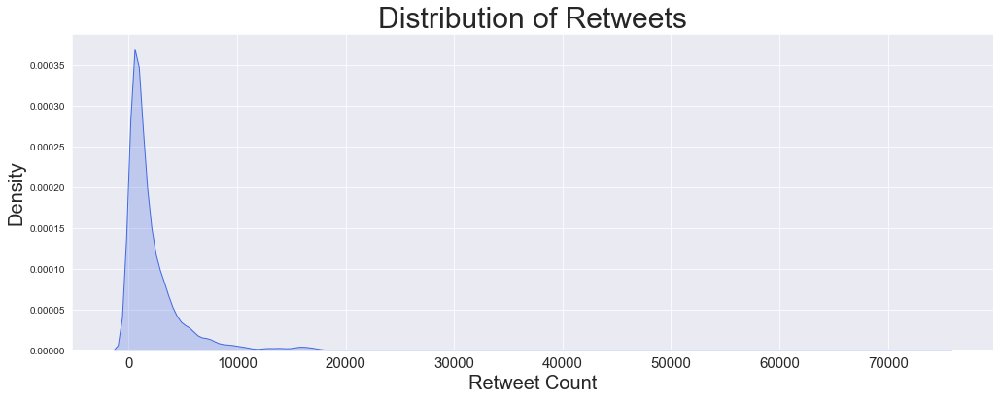

In [535]:
plt.figure(figsize = (17,6))
sns.kdeplot(df.retweet_count, shade=True, bw_adjust=0.5, color='royalblue')
plt.title('Distribution of Retweets', fontsize=30)
plt.ylabel('Density',fontsize=20)
plt.xlabel('Retweet Count', fontsize=20)
plt.xticks(fontsize=15);

<div style="text-align: justify">
    
From the above graph, it is evident that the distribution of retweet count (retweets) is positively skewed (right skewed) as it has very few large inputs at the end and based on calculations above median (50%) is closer to the first quartile (25%) as compared to the third quartile (75%). Also, the strength of skewness of retweet count distribution appears to be strong. Most of the data is accumulated upto 20000 retweet counts. Therefore, we will set the limit until 20000 to further investigate if there is any hidden trend in this distribution.
</div>

> **`Zooming In`**

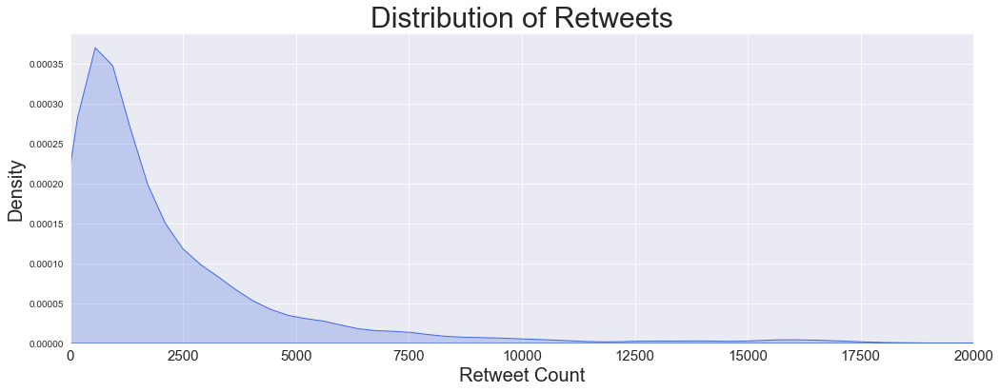

In [536]:
plt.figure(figsize = (17,6))
sns.kdeplot(df.retweet_count, shade=True, color='royalblue', bw_adjust=0.5)
plt.title('Distribution of Retweets', fontsize=30)
plt.ylabel('Density',fontsize=20)
plt.xlabel('Retweet Count', fontsize=20)
plt.xticks(fontsize=15)
plt.xlim(0,20000);

<div style="text-align: justify">

After zooming in, it is evident that the distribution of retweets is still positively skewed (right skewed) as it has very few large inputs at the end. Also, the strength of skewness of retweet count distribution is still strong. Also, it is important to note that the mean retweet count calculated above was approx. 2394 but the peak (most common retweet count) is observed below 1250. This is due to the fact that mean is influenced by the presence of extreme values and that is why it is not the most accurate measure of central tendency in this case. Thus, median which is approx. **`1162`** retweets, should be considered as the measure of central tendency.

</div>

### **Distribution of favorite count (likes)**

In [537]:
df.favorite_count.describe()

count    1998.000000  
mean     8052.871371  
std      11833.617705 
min      69.000000    
25%      1737.250000  
50%      3660.000000  
75%      9972.500000  
max      150731.000000
Name: favorite_count, dtype: float64

<div style="text-align: justify">
    
Median (50%) is closer to the first quartile (25%) as compared to the third quartile (75%).
</div> 

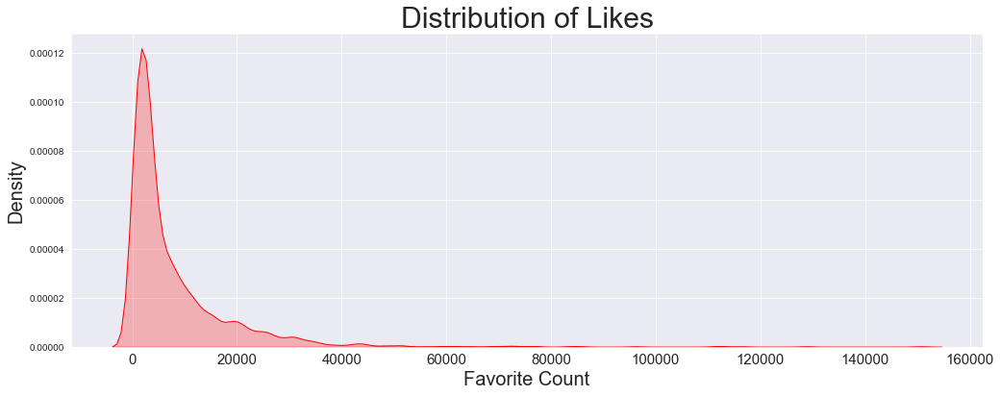

In [538]:
plt.figure(figsize = (17,6))
sns.kdeplot(df.favorite_count, shade=True, color='red', bw_adjust=0.5)
plt.title('Distribution of Likes', fontsize=30)
plt.ylabel('Density',fontsize=20)
plt.xlabel('Favorite Count', fontsize=20)
plt.xticks(fontsize=15);

<div style="text-align: justify">
    
From the above graph, it is evident that the distribution of favorite count (likes) is positively skewed (right skewed) as it has very few large inputs at the end and based on calculations above median (50%) is closer to the first quartile (25%) as compared to the third quartile (75%). Also, the strength of skewness of favorite count distribution appears to be strong. Most of the data is accumulated upto 50000 favorite counts. Therefore, we will set the limit until 50000 to further investigate if there is any hidden trend in this distribution.
</div> 

> **`Zooming In`**

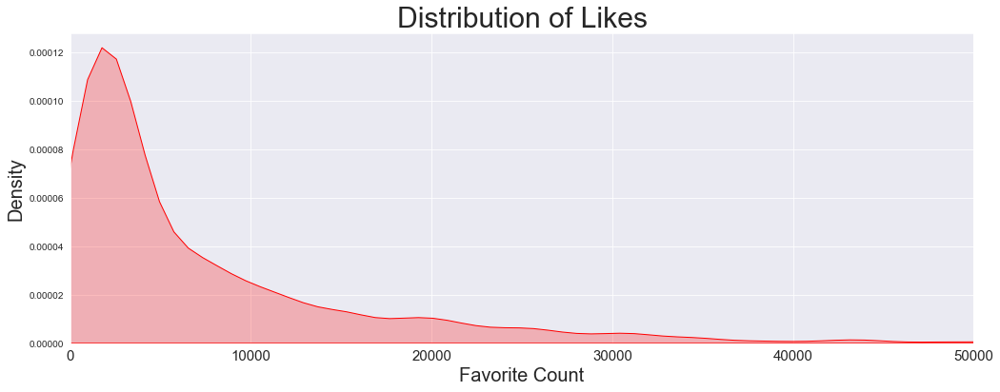

In [539]:
plt.figure(figsize = (17,6))
sns.kdeplot(df.favorite_count, shade=True, color='red', bw_adjust=0.5)
plt.title('Distribution of Likes', fontsize=30)
plt.ylabel('Density',fontsize=20)
plt.xlabel('Favorite Count', fontsize=20)
plt.xticks(fontsize=15)
plt.xlim(0,50000);

<div style="text-align: justify">
    
After zooming in, it is evident that the distribution of likes is still positively skewed (right skewed) as it has very few large inputs at the end. Also, the strength of skewness of favorite count distribution is still strong. Moreover, it is important to note that the mean favorite count calculated above was 8052 but the peak (most common favorite count) is observed below 5000. This is due to the fact that mean is influenced by the presence of extreme values and that is why it is not the most accurate measure of central tendency in this case. Thus, median which is **`3660`** likes, should be considered as the measure of central tendency.
</div> 

### **Distribution of rating numerator (ratings)**

In [540]:
df.rating_numerator.describe()

count    2005.000000
mean     12.272319  
std      41.373881  
min      0.000000   
25%      10.000000  
50%      11.000000  
75%      12.000000  
max      1776.000000
Name: rating_numerator, dtype: float64

<div style="text-align: justify">
    
Median (50%) is equally distant to the both the quartiles i.e. first quartile (25%) and the third quartile (75%).
</div>

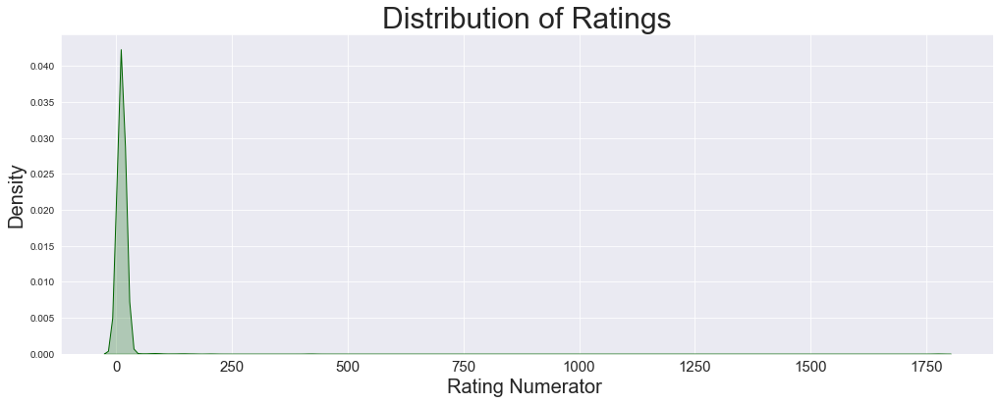

In [541]:
plt.figure(figsize = (17,6))
sns.kdeplot(df.rating_numerator, shade=True, color='darkgreen')
plt.title('Distribution of Ratings', fontsize=30)
plt.ylabel('Density',fontsize=20)
plt.xlabel('Rating Numerator ', fontsize=20)
plt.xticks(fontsize=15);

<div style="text-align: justify">
    
From the above graph, it seems that the distribution of rating numerator (ratings) is positively skewed (right skewed) as it has very few large inputs at the end but as per calculations above, median (50%) is equally distant to the both the quartiles i.e. first quartile (25%) and the third quartile (75%). Also, most of the data is accumulated upto 50 ratings. Therefore, we will set the limit until 50 to further investigate if there is any hidden trend in this distribution.
</div>

> **`Zooming In`**

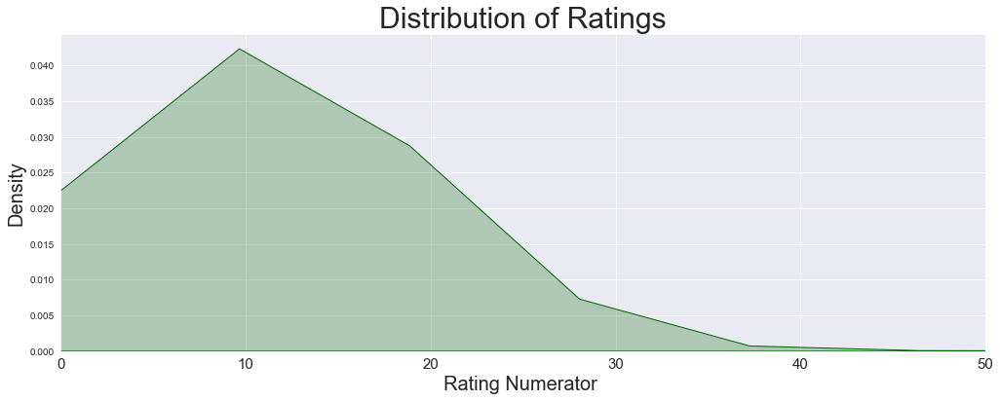

In [542]:
plt.figure(figsize = (17,6))
sns.kdeplot(df.rating_numerator, shade=True, color='darkgreen')
plt.title('Distribution of Ratings', fontsize=30)
plt.ylabel('Density',fontsize=20)
plt.xlabel('Rating Numerator ', fontsize=20)
plt.xticks(fontsize=15)
plt.xlim(0,50);

<div style="text-align: justify">
    
After zooming in, it seems that the distribution of ratings is not positively skewed and there is evidence to support this claim as median rating numerator calculated above which was 11 is equally distant to both the first (25%) and third quartiles (75%) calculated above i.e. 10 and 12 respectively. Also, the strength of skewness of ratings distribution is low. Moreover, the peak (most common rating numerator) is also observed in the same range of mean and median. Therefore, it can be said that the ratings distribution after zooming in is close to a normal distribution where mean apporx. **`12`** and median **`11`** both can be considered as measures of central tendency.
</div>

### **Analysis of dog stages**

In [543]:
df.dog_stage.value_counts()

pupper     212
doggo      74 
puppo      23 
floofer    8  
Name: dog_stage, dtype: int64

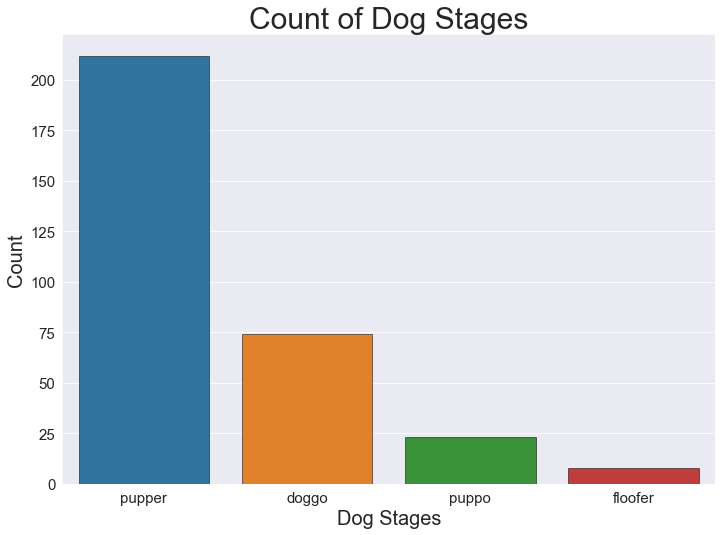

In [544]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.countplot(data=df, x='dog_stage', order= df.dog_stage.value_counts().index, linewidth=0.5, \
            edgecolor='black')
plt.title('Count of Dog Stages', fontsize=30)
plt.ylabel('Count',fontsize=20)
plt.xlabel('Dog Stages', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15);

<div style="text-align: justify">
    
It is evident from the above figure that pupper dog stage is the most popular dog stage amongst WeRateDogs's tweets with the number of tweets involving pupper dog stage is significantly higher than all the other dog stages **`(212)`**. There are **`74`** tweets with doggo dog stage and puppo dog stage having **`23`** tweets whereas floofer dog stage has the lowest number of tweets i.e. **`8`**. 
</div>

#### **Analysis of dog stages relative to retweets**

In [545]:
df.groupby('dog_stage').retweet_count.mean().sort_values(ascending=False)

dog_stage
doggo      6107.916667
puppo      6076.521739
floofer    4017.250000
pupper     2075.929245
Name: retweet_count, dtype: float64

In [546]:
df.groupby('dog_stage').retweet_count.median().sort_values(ascending=False)

dog_stage
floofer    2850.5
puppo      2695.0
doggo      2620.0
pupper     1051.5
Name: retweet_count, dtype: float64

<div style="text-align: justify">
    
It is interesting to note that the pupper dog stage which is the most popular dog stage amongst WeRateDogs's tweets based on previous findings has in fact the lowest average number of retweets as per mean and median measures but the doggo dog stage which is the second most popular dog stage in terms of tweets has the highest average number of retweets as per mean measure and the floofer dog stage which is the least popular dog stage in terms of tweets has surprisingly the highest average number of retweets as per median measure.

As we have seen in the above observations, retweets have very large inputs at the end and that is why median is more accurate measure of central tendency as compared to mean in the presence of these extreme values. Therefore, it would be safe to say that the floofer dog stage with approx. 2851 average number of retweets (median value) has the highest average number of retweets as compared to all the other dog stages mentioned in WeRateDog's twitter account. Moreover, more insights can be found on analyzing the retweet count distribution of each dog stage.
</div>

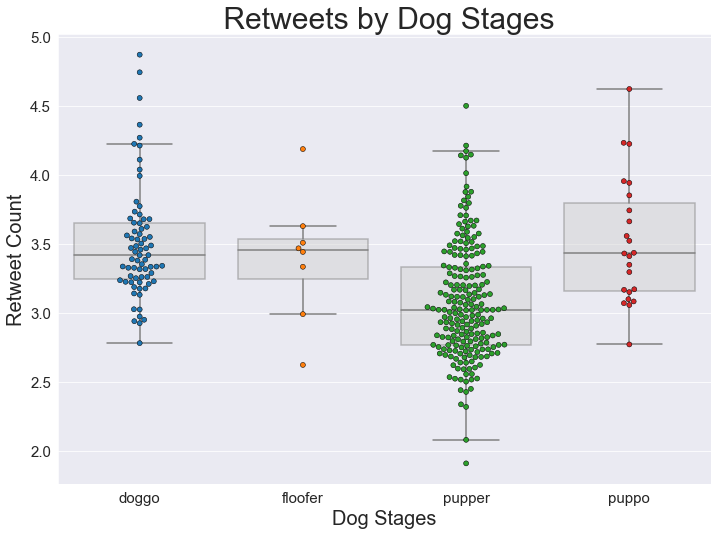

In [547]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
ax = sns.boxplot(data=df, x='dog_stage', y=np.log10(df.retweet_count), orient='v', color='lightgray', showfliers=False)
sns.swarmplot(data=df, x='dog_stage', y= np.log10(df.retweet_count), linewidth=0.5, edgecolor='black')
plt.title(' Retweets by Dog Stages', fontsize=30)
plt.ylabel('Retweet Count',fontsize=20)
plt.xlabel('Dog Stages', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
On analyzing the retweet count distribution relative to each dog stage from the above figure, it is interesting to note that there is no significant difference between the average number of retweets (as their median values are approx. same) among all the other dog stages except pupper and it has in fact the lowest average number of retweets as per median measure.
</div>

#### **Analysis of dog stages relative to likes**

In [548]:
df.groupby('dog_stage').favorite_count.mean().sort_values(ascending=False)

dog_stage
puppo      21300.347826
doggo      17866.479452
floofer    12130.250000
pupper     6708.198113 
Name: favorite_count, dtype: float64

In [549]:
df.groupby('dog_stage').favorite_count.median().sort_values(ascending=False)

dog_stage
puppo      13822.0
doggo      10564.0
floofer    10442.0
pupper     2985.0 
Name: favorite_count, dtype: float64

<div style="text-align: justify">
    
It is interesting to note that the pupper dog stage which is the most popular dog stage amongst WeRateDogs's tweets based on previous findings has in fact the lowest average number of likes as per mean and median measures but the puppo dog stage which is the second least popular dog stage in terms of tweets has the highest average number of likes as per mean and median measures.

As we have seen in the above observations, likes have very large inputs at the end and that is why median is more accurate measure of central tendency as compared to mean in the presence of these extreme values. Therefore, it would be safe to say that the puppo dog stage with 13822 average number of likes (median value) has the highest average number of likes as compared to all the other dog stages mentioned in WeRateDog's twitter account. Moreover, more insights can be found on analyzing the favorite count distribution of each dog stage.
</div>

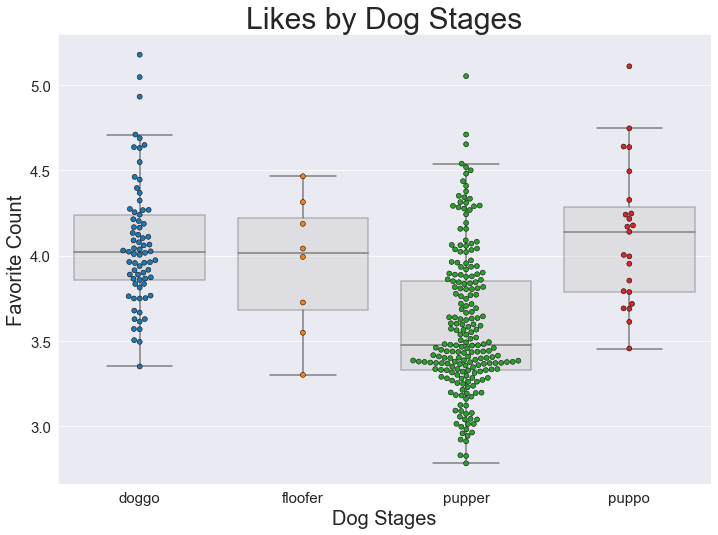

In [550]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
ax = sns.boxplot(data=df, x='dog_stage', y=np.log10(df.favorite_count), orient='v', color='lightgray', showfliers=False)
sns.swarmplot(data=df, x='dog_stage', y= np.log10(df.favorite_count), linewidth=0.5, edgecolor='black')
plt.title('Likes by Dog Stages', fontsize=30)
plt.ylabel('Favorite Count',fontsize=20)
plt.xlabel('Dog Stages', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
On analyzing the favorite count distribution relative to each dog stage from the above figure, it is interesting to note that there is no significant difference between the average number of likes (as both the median values are approx. same) among dog stages doggo and floofer. However, puppo dog stage which is the second least popular dog stage in terms of tweets has the highest average number of likes as per median measure. Moreover, pupper dog stage which is the most popular dog stage amongst WeRateDogs's tweets based on previous findings has in fact the lowest average number of likes as per median measure.
    
</div>

#### **Comparing both together**

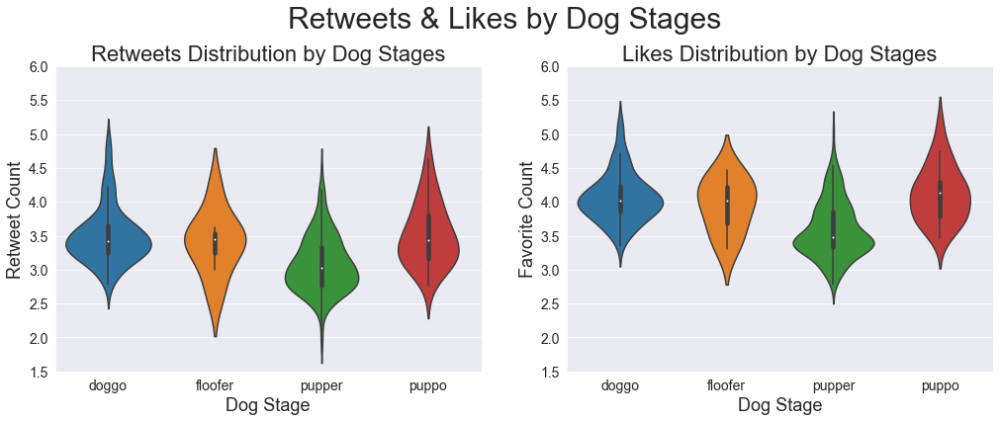

In [551]:
fig, axes = plt.subplots(1,2, sharex=True, figsize=(17,6))
#setting figure title
fig.suptitle('Retweets & Likes by Dog Stages ', fontsize=30)
#plotting the subplots
a= sns.violinplot(data=df, x='dog_stage', y= np.log10(df.retweet_count), ax=axes[0])
b= sns.violinplot(data=df, x='dog_stage', y= np.log10(df.favorite_count), ax=axes[1])
#setting title of subplots
axes[0].set_title('Retweets Distribution by Dog Stages', fontsize=22)
axes[1].set_title('Likes Distribution by Dog Stages', fontsize=22)
#setting ticks of subplots
axes[0].tick_params(axis='both', which='major', labelsize=14)
axes[1].tick_params(axis='both', which='major', labelsize=14)
#setting labels of subplots
axes[0].set_xlabel('Dog Stage', fontsize=18)
axes[0].set_ylabel('Retweet Count', fontsize=18)
axes[1].set_xlabel('Dog Stage', fontsize=18)
axes[1].set_ylabel('Favorite Count', fontsize=18)
#adjusting y axis limits
a.set(ylim=(1.5,6))
b.set(ylim=(1.5,6))
#adjusting figure main title
fig.subplots_adjust(top =0.84);

<div style="text-align: justify">
    
While, boxplots combined with swarmplots above were easy to compare the median number of retweets among different dog stages. Here we have used violin plots to easily compare the distribution of retweets amongst different dog stages. 
    
**Retweets Distribution:**It is evident from the above figure that floofer dog stage has majority of the tweets with high number of retweets as the violin plot for floofer stage is wider above its median (centre) implicating high probability of tweets in that region whereas for the other dog stages i.e. puppo and pupper have their violin plots wider below their median values implicating high probability of tweets in that regions and thus it can be said that the majority of the tweets for these dog stages have less number of retweets. Doggo stage has its violin plot wider around the median and therefore indicating that majority of the tweets for doggo dog stage have retweets centered around the median.
        
**Likes Distribution:**It is evident from the above figure that floofer dog stage has majority of the tweets with high number of likes as the violin plot for floofer stage is wider above its median (centre) implicating high probability of tweets in that region whereas for the doggo dog stage it has its violin plot wide in the middle and tampered only at one end i.e. above the median and therefore indicating that majority of the tweets for doggo dog stage have less number of likes. Furthermore, pupper dog stage has its violin plot wider below its median value implicating high probability of tweets in that region and thus it can be said that the majority of the tweets for pupper dog stage have less number of likes. Also, puppo dog stage has majority of the tweets with high number of likes as the violin plot for puppo stage is wider above its median (centre) implicating high probability of tweets in that region.
    
    
Thus, violin plots have provided more accurate interpretation of the retweets and likes distribution relative to each dog stage in an easy manner.
</div>

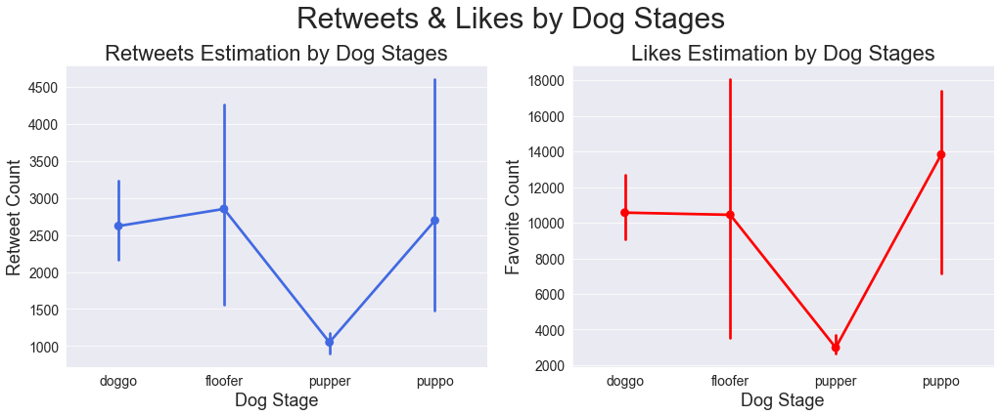

In [552]:
fig, axes = plt.subplots(1,2,figsize=(17,6), sharex=True)
#setting figure title
fig.suptitle('Retweets & Likes by Dog Stages ', fontsize=30)
#plotting the subplots
a= sns.pointplot(data=df, x='dog_stage', y= df.retweet_count, estimator=median, ax=axes[0], color='royalblue')
b= sns.pointplot(data=df, x='dog_stage', y= df.favorite_count, estimator=median, ax=axes[1], color='red')
#setting title of subplots
axes[0].set_title('Retweets Estimation by Dog Stages', fontsize=22)
axes[1].set_title('Likes Estimation by Dog Stages', fontsize=22)
#setting ticks of subplots
axes[0].tick_params(axis='both', which='major', labelsize=14)
axes[1].tick_params(axis='both', which='major', labelsize=14)
#setting labels of subplots
axes[0].set_xlabel('Dog Stage', fontsize=18)
axes[0].set_ylabel('Retweet Count', fontsize=18)
axes[1].set_xlabel('Dog Stage', fontsize=18)
axes[1].set_ylabel('Favorite Count', fontsize=18)
##adjusting figure main title
fig.subplots_adjust(top =0.84);

<div style="text-align: justify">
    
1.The pupper dog stage which is the most popular dog stage amongst WeRateDogs's tweets based on previous findings has in fact the lowest average number of retweets but the floofer dog stage which is the least popular dog stage with approx. **`2851`** average number of retweets has surprisingly the highest average number of retweets.  

2.The pupper dog stage also has infact the lowest average number of likes but the puppo dog stage which is the second least popular dog stage in terms of tweets with **`13822`** average number of likes has the highest average number of likes whereas doggo and floofer have approximately same average number of likes.

</div>

### **Likes v/s Retweets**

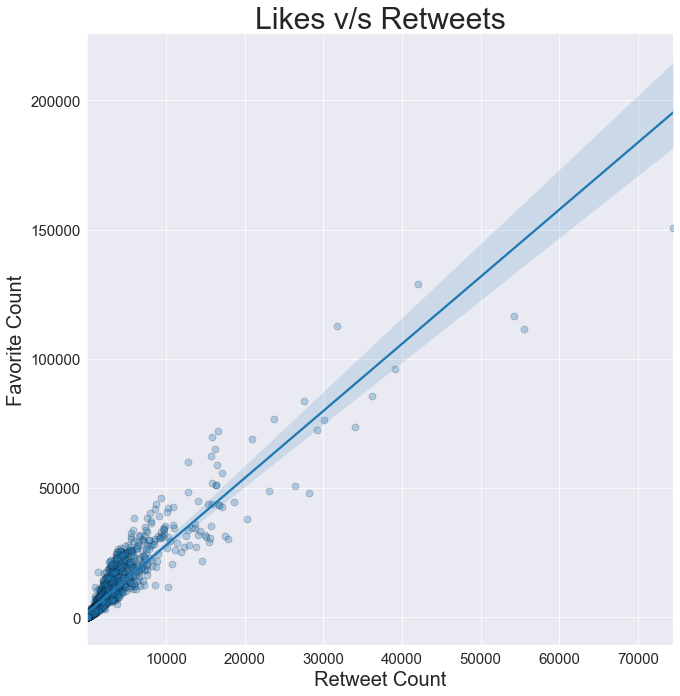

In [553]:
sns.lmplot(data=df, x='retweet_count', y='favorite_count', size=9, 
           scatter_kws = dict(alpha=0.3, s=50, edgecolor='black', linewidth=0.5))
plt.title('Likes v/s Retweets', fontsize=30)
plt.ylabel('Favorite Count',fontsize=20)
plt.xlabel('Retweet Count', fontsize=20);
plt.xticks(fontsize=15)
plt.yticks(fontsize=15);

<div style="text-align: justify">
    
As per the above figure, it is evident that retweets and likes are correlated and they have a strong linear relationship between them. But as we can see, most of the data is accumulated at the start as both the variables have positively skewed distribution implicating the need for further transformation to investigate their relationship.

</div>

#### **Relationship after normalising data (log transformation)**

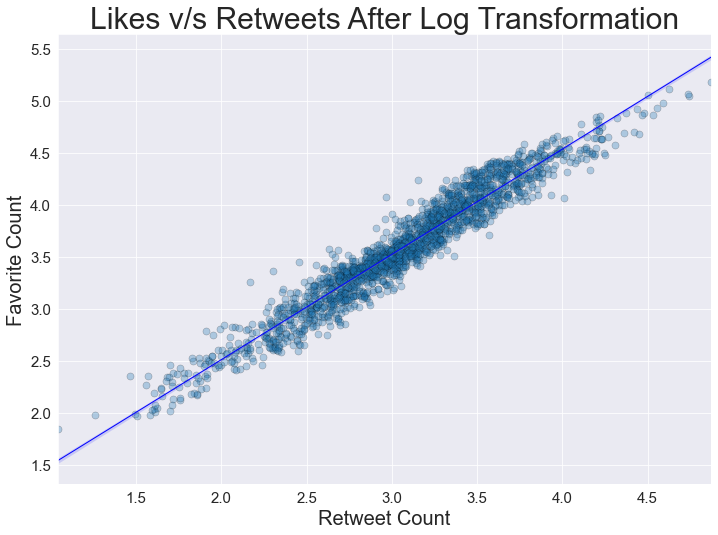

In [554]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.regplot(data = df, x=np.log10(df.retweet_count), y=np.log10(df.favorite_count), fit_reg=True,
            scatter_kws=dict(alpha=0.3,s=50, edgecolor='black', linewidth=0.5), line_kws = dict(ls='-',lw=1, color='blue'))
plt.title('Likes v/s Retweets After Log Transformation', fontsize=30)
plt.ylabel('Favorite Count',fontsize=20)
plt.xlabel('Retweet Count', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
After performing the log transformation to both the variables, we can clearly see that likes and retweets are highly correlated and they have a strong linear relationship between them as the slope of the line in the above figure is high.

</div>

### **Analysis of dog stages relative to ratings (numerators)**

In [555]:
df.groupby('dog_stage').rating_numerator.mean().sort_values(ascending=False)

dog_stage
puppo      12.043478
floofer    11.875000
doggo      11.783784
pupper     10.726415
Name: rating_numerator, dtype: float64

In [556]:
df.groupby('dog_stage').rating_numerator.median().sort_values(ascending=False)

dog_stage
puppo      12
floofer    12
doggo      12
pupper     11
Name: rating_numerator, dtype: int64

<div style="text-align: justify">
    
It is evident that there is no significant difference between the average number of ratings for all the dog stages in terms of mean and median measures. Also, unlike retweets and likes, the mean and median rating values for all the dog stages is approx. same as after zooming in the previous observations, it was found that the rating numerator is close to a normal distribution.
</div>

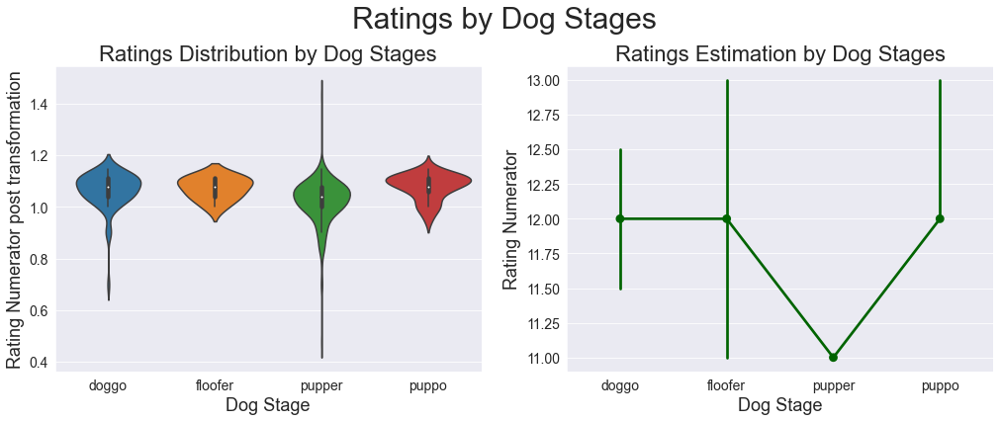

In [557]:
fig, axes = plt.subplots(1,2,figsize=(17,6), sharex=True)
#setting figure title
fig.suptitle('Ratings by Dog Stages ', fontsize=30)
#plotting the subplots
a= sns.violinplot(data=df, x='dog_stage', y= np.log10(df.rating_numerator), ax=axes[0])
b= sns.pointplot(data=df, x='dog_stage', y= df.rating_numerator, estimator=median, ax=axes[1], color='darkgreen')
#setting title of subplots
axes[0].set_title('Ratings Distribution by Dog Stages', fontsize=22)
axes[1].set_title('Ratings Estimation by Dog Stages', fontsize=22)
#setting ticks of subplots
axes[0].tick_params(axis='both', which='major', labelsize=14)
axes[1].tick_params(axis='both', which='major', labelsize=14)
#setting labels of subplots
axes[0].set_xlabel('Dog Stage', fontsize=18)
axes[0].set_ylabel('Rating Numerator post transformation', fontsize=18)
axes[1].set_xlabel('Dog Stage', fontsize=18)
axes[1].set_ylabel('Rating Numerator', fontsize=18)
#adjusting figure main title
fig.subplots_adjust(top =0.84);

<div style="text-align: justify">
    
1.It is evident from the above figure that all the dog stages doggo, floofer, puppo and pupper have their violin plots wider exactly at the middle implicating high probability of tweets in that region and thus it can be said that majority of the tweets for all these dog stages have ratings centered around the median.
    
2.The above findings are further supported by the fact that the pupper dog stage which is the most popular dog stage amongst WeRateDogs's tweets based on previous findings has average number of ratings i.e. 11 (median) as compared to all the other dog stages who have the same average number of ratings i.e. 12 (median). Overall, the difference between the average number of ratings for all the dog stages is insignificant.

</div>

### **Retweets v/s Ratings**

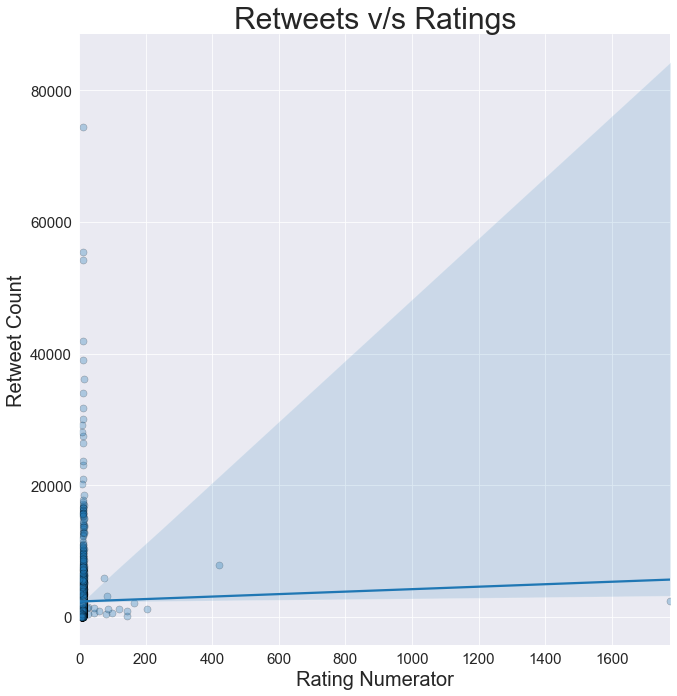

In [558]:
sns.lmplot(data=df, y='retweet_count', x='rating_numerator', size=9, 
           scatter_kws = dict(alpha=0.3, s=50, edgecolor='black', linewidth=0.5));
plt.title('Retweets v/s Ratings', fontsize=30)
plt.ylabel('Retweet Count',fontsize=20)
plt.xlabel('Rating Numerator', fontsize=20);
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
As per the above figure, it appears that retweets and ratings are not correlated and they do not have a strong linear relationship between them. But as we can see, most of the data is accumulated at the start as retweet variable has positively skewed distribution, hence, implicating the need for further transformation to investigate their relationship.

</div>

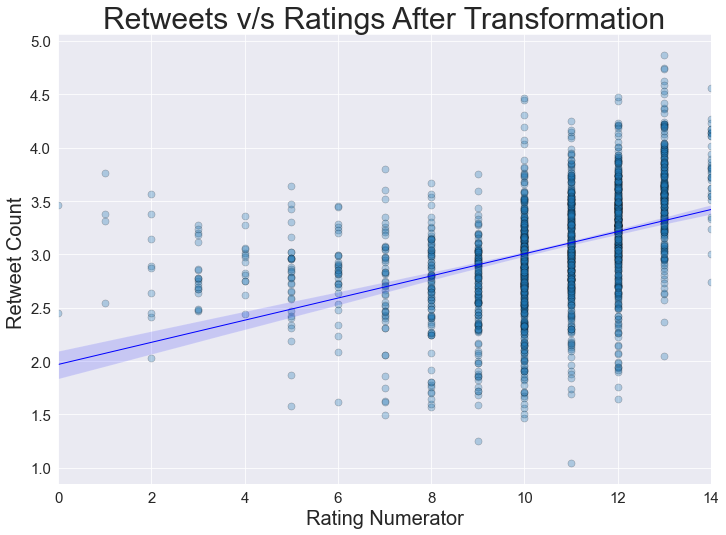

In [559]:
df_reg = df.query('rating_numerator <= 20')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.regplot(data = df_reg, x=df_reg.rating_numerator, y=np.log10(df_reg.retweet_count), fit_reg=True,
            scatter_kws = dict(alpha=0.3, s=50, edgecolor='black', linewidth=0.5), line_kws= dict(ls='-', lw=1, color='blue'))
plt.title('Retweets v/s Ratings After Transformation', fontsize=30)
plt.ylabel('Retweet Count ',fontsize=20)
plt.xlabel('Rating Numerator', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
However, after performing the log transformation to the retweet variable, we can clearly see that retweets and ratings are correlated and the strength of the linear relationship between them is moderate.

</div>

### **Likes v/s Ratings**

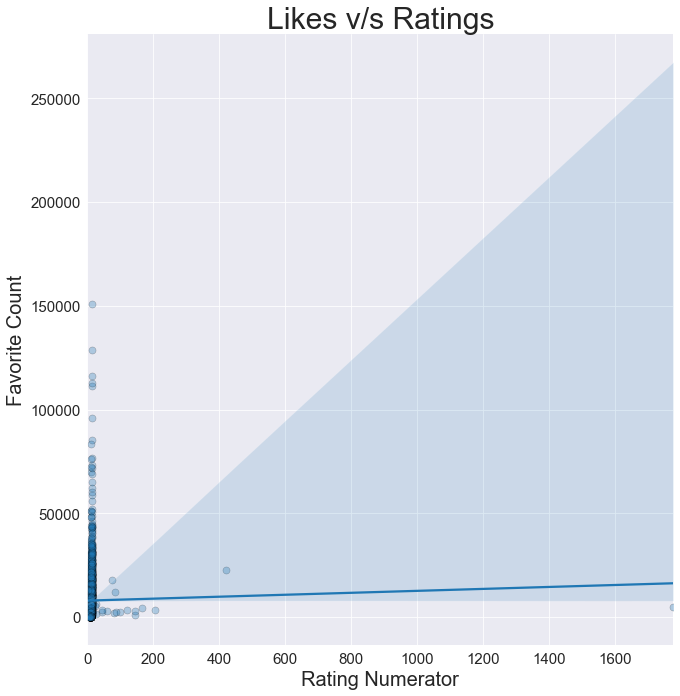

In [560]:
sns.lmplot(data=df, y='favorite_count', x='rating_numerator', size=9, 
           scatter_kws = dict(alpha=0.3,s=50, edgecolor='black', linewidth=0.5));
plt.title('Likes v/s Ratings', fontsize=30)
plt.ylabel('Favorite Count',fontsize=20)
plt.xlabel('Rating Numerator', fontsize=20);
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
As per the above figure, it appears that likes and ratings are not correlated and they do not have a strong linear relationship between them. But as we can see, most of the data is accumulated at the start as likes variable has positively skewed distribution, hence, implicating the need for further transformation to investigate their relationship.

</div>

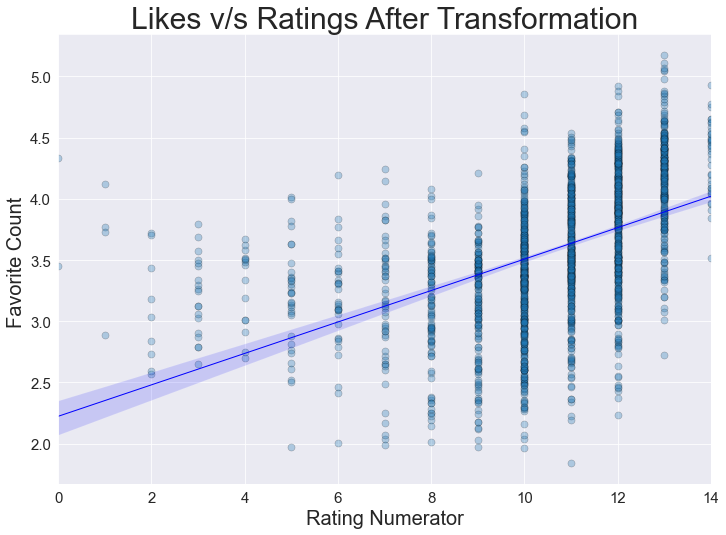

In [561]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.regplot(data=df_reg, x=df_reg.rating_numerator, y=np.log10(df_reg.favorite_count), fit_reg=True,
            scatter_kws = dict(alpha=0.3, s=50, edgecolor='black', linewidth=0.5), line_kws= dict(ls='-', lw=1, color='blue'))
plt.title('Likes v/s Ratings After Transformation', fontsize=30)
plt.ylabel('Favorite Count ',fontsize=20)
plt.xlabel('Rating Numerator', fontsize=20)
plt.setp(ax.artists, alpha=0.5)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.setp(ax.artists, alpha=0.5);

<div style="text-align: justify">
    
However, after performing the log transformation to the likes variable, we can clearly see that likes and ratings are correlated and the strength of the linear relationship between them is moderate.

</div>

### **Comparing both together**

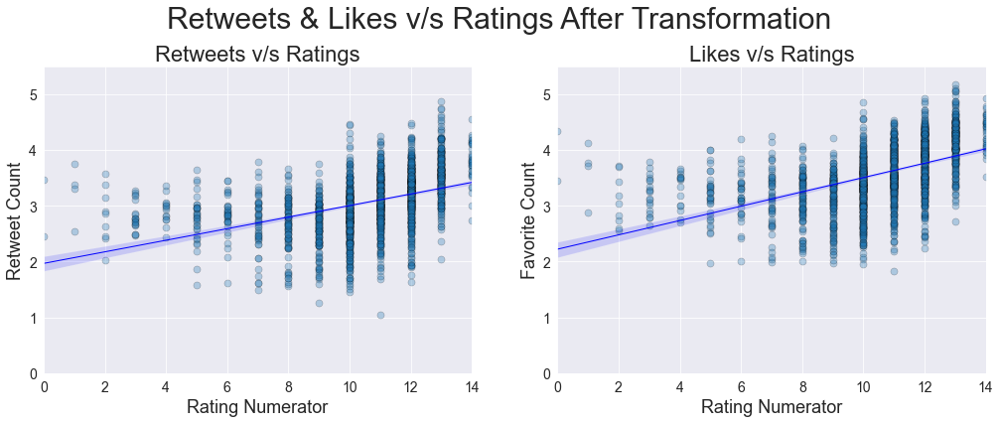

In [562]:
fig, axes = plt.subplots(1,2,figsize=(17,6), sharex=True)
#setting figure title
fig.suptitle('Retweets & Likes v/s Ratings After Transformation', fontsize=30)
#plotting the subplots
a=sns.regplot(data = df_reg, x=df_reg.rating_numerator, y=np.log10(df_reg.retweet_count), fit_reg=True, \
            scatter_kws = dict(alpha=0.3, s=50, edgecolor='black', linewidth=0.5), line_kws= dict(ls='-', lw=1, color='blue'), \
            ax=axes[0])
b=sns.regplot(data=df_reg, x=df_reg.rating_numerator, y=np.log10(df_reg.favorite_count), fit_reg=True,
            scatter_kws = dict(alpha=0.3, s=50, edgecolor='black', linewidth=0.5), line_kws= dict(ls='-', lw=1, color='blue'), \
             ax=axes[1])
#setting title of subplots
axes[0].set_title('Retweets v/s Ratings', fontsize=22)
axes[1].set_title('Likes v/s Ratings', fontsize=22)
#setting ticks of subplots
axes[0].tick_params(axis='both', which='major', labelsize=14)
axes[1].tick_params(axis='both', which='major', labelsize=14)
#setting labels of subplots
axes[0].set_ylabel('Retweet Count', fontsize=18)
axes[0].set_xlabel('Rating Numerator', fontsize=18)
axes[1].set_ylabel('Favorite Count', fontsize=18)
axes[1].set_xlabel('Rating Numerator', fontsize=18)
#adjusting y axis limits
a.set(ylim=(0,5.5))
b.set(ylim=(0,5.5))
#adjusting figure main title
fig.subplots_adjust(top =0.84);

<div style="text-align: justify">
    
After performing the transformation to both the variables i.e. retweets and likes, we can clearly see that retweets and likes both are correlated with ratings. However, likes has a stronger linear relationship with ratings as compared to retweets. But overall, the difference between the strength of their relationship with ratings is insignificant as lines in both the graphs have approx. same slope.

</div>

### **Most Popular Dog Breeds (Top 5)**

In [563]:
df.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A,6401.0,28981.0,https://pbs.twimg.com/media/DFrEyVuW0AAO3t9.jpg,1,Pembroke,0.511319,True,Cardigan,0.451038,True,Chihuahua,0.029248,True
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ,2621.0,18579.0,https://pbs.twimg.com/media/DEUtQbzW0AUTv_o.jpg,1,German_shepherd,0.707046,True,malinois,0.199396,True,Norwegian_elkhound,0.049148,True
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR,4780.0,24945.0,https://pbs.twimg.com/media/DB1m871XUAAw5vZ.jpg,2,Labrador_retriever,0.476913,True,Chesapeake_Bay_retriever,0.174145,True,German_short-haired_pointer,0.092861,True
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw,3079.0,18522.0,https://pbs.twimg.com/media/DBg_HT9WAAEeIMM.jpg,2,komondor,0.974781,True,briard,0.020041,True,swab,0.003228,False
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo,2774.0,14711.0,https://pbs.twimg.com/media/DBFtiYqWAAAsjj1.jpg,1,Chihuahua,0.955156,True,toy_terrier,0.008054,True,muzzle,0.006296,False


In [564]:
df.columns

Index(['tweet_id', 'in_reply_to_status_id', 'in_reply_to_user_id', 'timestamp',
       'source', 'text', 'expanded_urls', 'rating_numerator',
       'rating_denominator', 'name', 'dog_stage', 'tweet_url', 'retweet_count',
       'favorite_count', 'jpg_url', 'img_num', 'p1', 'p1_conf', 'p1_dog', 'p2',
       'p2_conf', 'p2_dog', 'p3', 'p3_conf', 'p3_dog'],
      dtype='object')

In [565]:
# Focusing only on top prediction
df.drop(['p2','p2_conf', 'p2_dog', 'p3', 'p3_conf', 'p3_dog'], axis=1, inplace=True)

In [566]:
# Dataframe which contains true predictions (top prediction) of dog breed
df_true = df.query('p1_dog == True')
df_true.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_url,retweet_count,favorite_count,jpg_url,img_num,p1,p1_conf,p1_dog
0,890240255349198849,NaN,NaN,2017-07-26 15:59:51+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cassie. She is a college pup. Studying international doggo communication and stick theory. 14/10 so elegant much sophisticate,https://twitter.com/dog_rates/status/890240255349198849/photo/1,14,10,Cassie,doggo,https://t.co/t1bfwz5S2A,6401.0,28981.0,https://pbs.twimg.com/media/DFrEyVuW0AAO3t9.jpg,1,Pembroke,0.511319,True
1,884162670584377345,NaN,NaN,2017-07-09 21:29:42+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Yogi. He doesn't have any important dog meetings today he just enjoys looking his best at all times. 12/10 for dangerously dapper doggo,https://twitter.com/dog_rates/status/884162670584377345/photo/1,12,10,Yogi,doggo,https://t.co/YSI00BzTBZ,2621.0,18579.0,https://pbs.twimg.com/media/DEUtQbzW0AUTv_o.jpg,1,German_shepherd,0.707046,True
2,872967104147763200,NaN,NaN,2017-06-09 00:02:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a very large dog. He has a date later. Politely asked this water person to check if his breath is bad. 12/10 good to go doggo,"https://twitter.com/dog_rates/status/872967104147763200/photo/1,https://twitter.com/dog_rates/status/872967104147763200/photo/1",12,10,NaN,doggo,https://t.co/EMYIdoblMR,4780.0,24945.0,https://pbs.twimg.com/media/DB1m871XUAAw5vZ.jpg,2,Labrador_retriever,0.476913,True
3,871515927908634625,NaN,NaN,2017-06-04 23:56:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Napolean. He's a Raggedy East Nicaraguan Zoom Zoom. Runs on one leg. Built for deception. No eyes. Good with kids. 12/10 great doggo,"https://twitter.com/dog_rates/status/871515927908634625/photo/1,https://twitter.com/dog_rates/status/871515927908634625/photo/1",12,10,Napolean,doggo,https://t.co/PR7B7w1rUw,3079.0,18522.0,https://pbs.twimg.com/media/DBg_HT9WAAEeIMM.jpg,2,komondor,0.974781,True
4,869596645499047938,NaN,NaN,2017-05-30 16:49:31+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scout. He just graduated. Officially a doggo now. Have fun with taxes and losing sight of your ambitions. 12/10 would throw cap for,"https://twitter.com/dog_rates/status/869596645499047938/photo/1,https://twitter.com/dog_rates/status/869596645499047938/photo/1",12,10,Scout,doggo,https://t.co/DsA2hwXAJo,2774.0,14711.0,https://pbs.twimg.com/media/DBFtiYqWAAAsjj1.jpg,1,Chihuahua,0.955156,True


In [567]:
# Total number of topmost predictions
total_preds = df_true.p1.count()
total_preds

1487

In [568]:
# Most Popular Breeds for topmost predictions
popular_preds = df_true.p1.value_counts().head()
popular_preds

golden_retriever      143
Labrador_retriever    96 
Pembroke              88 
Chihuahua             79 
pug                   54 
Name: p1, dtype: int64

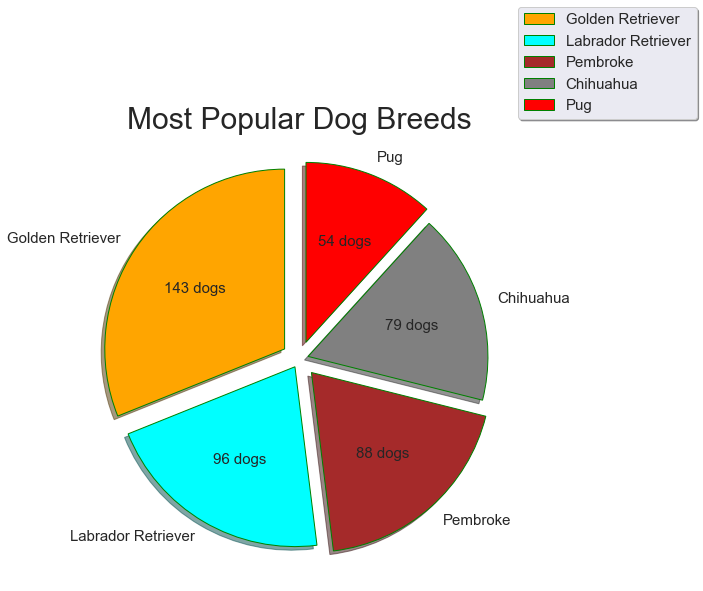

In [569]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
labels=['Golden Retriever','Labrador Retriever','Pembroke', 'Chihuahua','Pug']
colors=['orange','cyan','brown','grey','red']
explode=(0.1,0.05,0.1,0.05,0.1)
wp= {'linewidth': 1, 'edgecolor': 'green'}
ax = plt.pie(x=popular_preds, labels=labels, explode=explode, colors=colors, wedgeprops=wp, textprops={'fontsize':15},
             shadow=True, startangle=90, autopct=lambda p:f'{p*sum(popular_preds)/100 :.0f} dogs')
plt.title('Most Popular Dog Breeds', fontsize=30)
plt.legend(loc='upper right', bbox_to_anchor=(1.40,1.30), frameon=True, fancybox=True, shadow=True, framealpha=1,\
           prop={'size':15});

<div style="text-align: justify">
    
It is evident from the above figure that Golden Retriever is the most popular dog breed amongst WeRateDogs's tweets in terms of the number of image predictions having 143 dogs. The second most popular dog breed is Labrador Retriever (96 dogs) followed by Pembroke (88 dogs) and Chihuahua (79 dogs). The fifth most popular dog breed is Pug (54 dogs).

</div>

### **Least Popular Dog Breeds (Top 5)**

In [570]:
# Least Popular Breeds
unpopular_preds = df_true.p1.value_counts().tail()
unpopular_preds

silky_terrier         1
standard_schnauzer    1
Scotch_terrier        1
groenendael           1
EntleBucher           1
Name: p1, dtype: int64

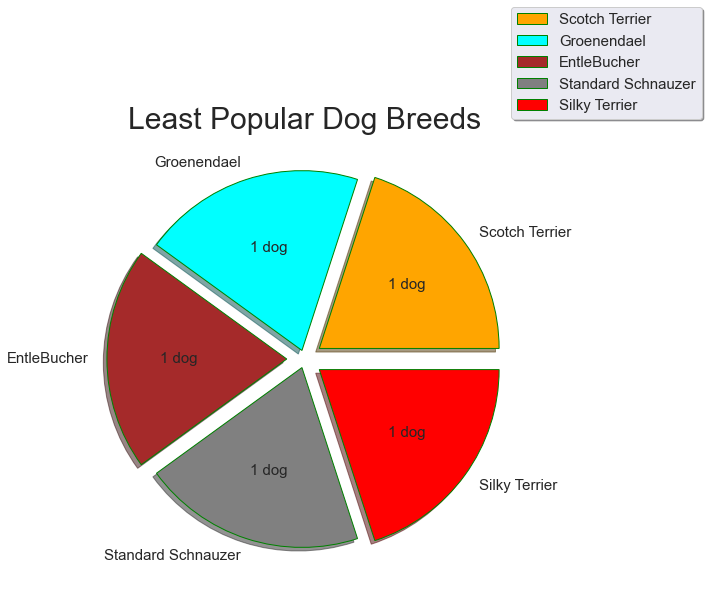

In [571]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
labels=['Scotch Terrier','Groenendael','EntleBucher','Standard Schnauzer','Silky Terrier']
colors=['orange','cyan','brown','grey','red']
explode=(0.1,0.05,0.1,0.05,0.1)
wp= {'linewidth': 1, 'edgecolor': 'green'}
ax = plt.pie(x=unpopular_preds, labels=labels, explode=explode, colors=colors, wedgeprops=wp, textprops={'fontsize':15},
             shadow=True, autopct=lambda p:f'{p*sum(unpopular_preds)/100 :.0f} dog')
plt.title('Least Popular Dog Breeds', fontsize=30)
plt.legend(loc='upper right', bbox_to_anchor=(1.40,1.30), frameon=True, fancybox=True, shadow=True, framealpha=1,\
           prop={'size':15});

<div style="text-align: justify">
    
It is evident from the above figure that the top five least popular dog breeds namely Scotch Terrier, Silky Terrier, Groenendael, EntleBucher and Standard Schnauzer have the same number of dogs (number of image predictions) i.e. 1.
</div>

### **Dogs with most likes (Top 5)**

In [572]:
# Highest Favorite counts (Top 5)
df.favorite_count.sort_values(ascending=False).head()

64     150731.0
303    128847.0
646    116396.0
89     112846.0
66     111460.0
Name: favorite_count, dtype: float64

In [573]:
ind = df.favorite_count.sort_values(ascending=False).head().index

In [574]:
# Details of Dogs with most likes (Tweet Details)
df_mostlikes = df.loc[np.r_[ind],['favorite_count','tweet_id','text','name','dog_stage','retweet_count', \
                                               'rating_numerator','rating_denominator', 'p1','jpg_url', 'p1_dog']]
df_mostlikes.reset_index(drop=True, inplace=True)

In [575]:
# Dogs with MOST LIKES
df_mostlikes

,favorite_count,tweet_id,text,name,dog_stage,retweet_count,rating_numerator,rating_denominator,p1,jpg_url,p1_dog
0,150731.0,744234799360020481,Here's a doggo realizing you can stand in a pool. 13/10 enlightened af (vid by Tina Conrad),NaN,doggo,74466.0,13,10,Labrador_retriever,https://pbs.twimg.com/ext_tw_video_thumb/744234667679821824/pu/img/1GaWmtJtdqzZV7jy.jpg,True
1,128847.0,822872901745569793,Here's a super supportive puppo participating in the Toronto #WomensMarch today. 13/10,NaN,puppo,41982.0,13,10,Lakeland_terrier,https://pbs.twimg.com/media/C2tugXLXgAArJO4.jpg,True
2,116396.0,807106840509214720,This is Stephan. He just wants to help. 13/10 such a good boy,Stephan,NaN,54299.0,13,10,Chihuahua,https://pbs.twimg.com/ext_tw_video_thumb/807106774843039744/pu/img/8XZg1xW35Xp2J6JW.jpg,True
3,112846.0,866450705531457537,"This is Jamesy. He gives a kiss to every other pupper he sees on his walk. 13/10 such passion, much tender",Jamesy,pupper,31683.0,13,10,French_bulldog,https://pbs.twimg.com/media/DAZAUfBXcAAG_Nn.jpg,True
4,111460.0,739238157791694849,Here's a doggo blowing bubbles. It's downright legendary. 13/10 would watch on repeat forever (vid by Kent Duryee),NaN,doggo,55489.0,13,10,Eskimo_dog,https://pbs.twimg.com/ext_tw_video_thumb/739238016737267712/pu/img/-tLpyiuIzD5zR1et.jpg,True


<div style="text-align: justify">
    
It is worth noticing from the above table that all the dogs with highest number of likes also have high retweets and it is expected as likes and retweets are highly correlated i.e. if we increase the number of likes, the number of retweets also increases but it does not imply causation i.e. the increase in retweets is caused by the increase in likes as there might be an another variable responsible for increase in both. Therefore, in order to check whether causation also exists between likes and retweets along with correlation, we need to make use of statistical techniques such as Hypothesis Testing or A/B Testing.
</div>

> **`Below all the details such as name, dog stage, dog breed, number of retweets and ratings regarding each dog of the top five dogs with most likes are provided`**

# **1**

In [576]:
df_mostlikes.loc[0,['name', 'favorite_count','dog_stage','p1','retweet_count','rating_numerator']]

name                NaN               
favorite_count      150731            
dog_stage           doggo             
p1                  Labrador_retriever
retweet_count       74466             
rating_numerator    13                
Name: 0, dtype: object

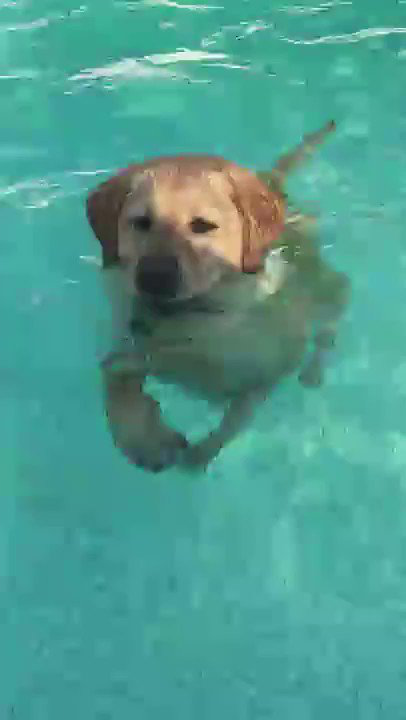

In [577]:
no1_url = df_mostlikes.jpg_url[0]
r = requests.get(no1_url)
Image.open(BytesIO(r.content))

# **2**

In [578]:
df_mostlikes.loc[1,['name', 'favorite_count','dog_stage','p1','retweet_count','rating_numerator']]

name                NaN             
favorite_count      128847          
dog_stage           puppo           
p1                  Lakeland_terrier
retweet_count       41982           
rating_numerator    13              
Name: 1, dtype: object

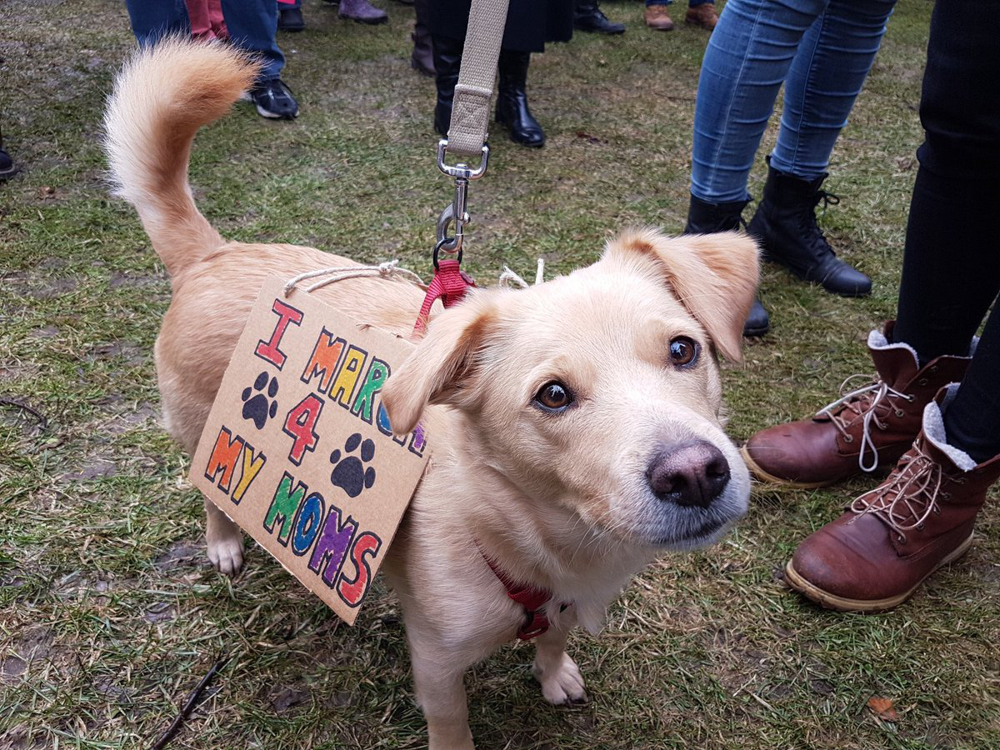

In [579]:
no2_url = df_mostlikes.jpg_url[1]
r = requests.get(no2_url)
Image.open(BytesIO(r.content))

# **3**

In [580]:
df_mostlikes.loc[2,['name', 'favorite_count','dog_stage','p1','retweet_count','rating_numerator']]

name                Stephan  
favorite_count      116396   
dog_stage           NaN      
p1                  Chihuahua
retweet_count       54299    
rating_numerator    13       
Name: 2, dtype: object

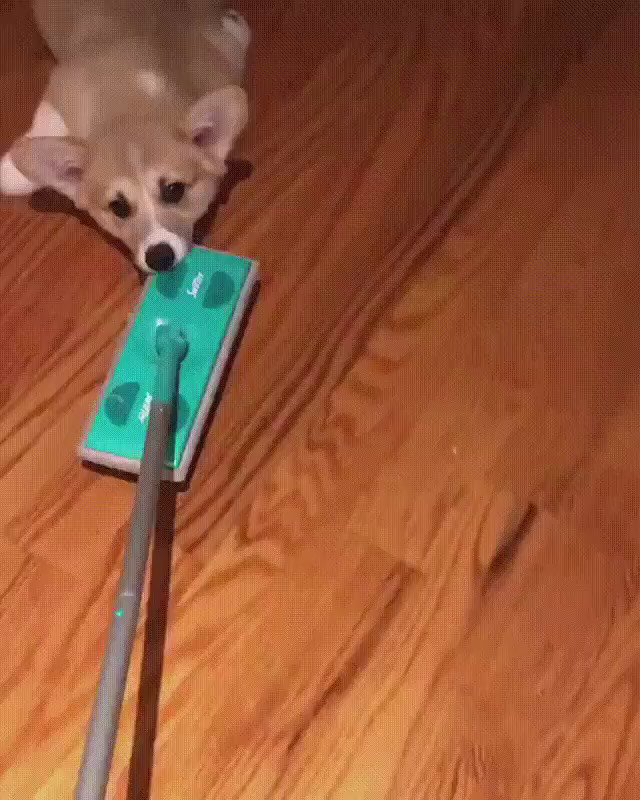

In [581]:
no3_url = df_mostlikes.jpg_url[2]
r = requests.get(no3_url)
Image.open(BytesIO(r.content))

# **4**

In [582]:
df_mostlikes.loc[3,['name', 'favorite_count','dog_stage','p1','retweet_count','rating_numerator']]

name                Jamesy        
favorite_count      112846        
dog_stage           pupper        
p1                  French_bulldog
retweet_count       31683         
rating_numerator    13            
Name: 3, dtype: object

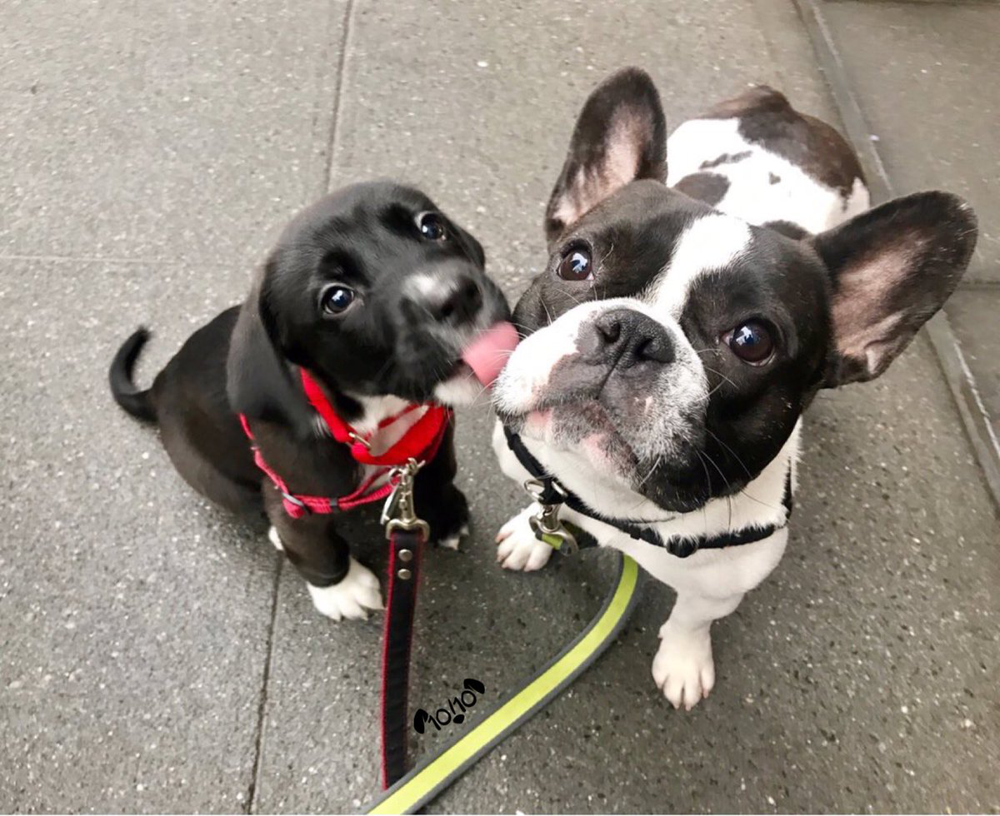

In [583]:
no4_url = df_mostlikes.jpg_url[3]
r = requests.get(no4_url)
Image.open(BytesIO(r.content))

# **5**

In [584]:
df_mostlikes.loc[4,['name', 'favorite_count','dog_stage','p1','retweet_count','rating_numerator']]

name                NaN       
favorite_count      111460    
dog_stage           doggo     
p1                  Eskimo_dog
retweet_count       55489     
rating_numerator    13        
Name: 4, dtype: object

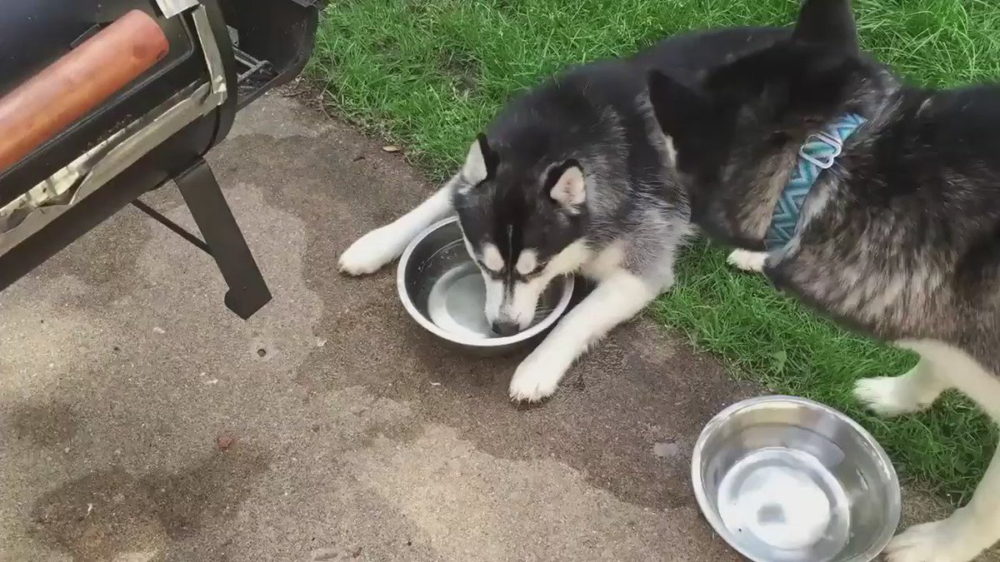

In [585]:
no5_url = df_mostlikes.jpg_url[4]
r = requests.get(no5_url)
Image.open(BytesIO(r.content))

### **Dogs with least retweets (Top 5)**

In [586]:
# Lowest Retweet counts (Top 5)
df.retweet_count.sort_values().head()

1988    11.0
1968    18.0
1876    29.0
1976    31.0
1986    32.0
Name: retweet_count, dtype: float64

In [587]:
ind = df.retweet_count.sort_values().head().index

In [588]:
# Details of Dogs with least retweets (Tweet Details)
df_leasttweets = df.loc[np.r_[ind],[ 'retweet_count','tweet_id','text','name','dog_stage', 'favorite_count', \
                                               'rating_numerator','rating_denominator', 'p1','jpg_url', 'p1_dog']]
df_leasttweets.reset_index(drop=True, inplace=True)

In [589]:
# Dogs with LEAST RETWEETS
df_leasttweets

,retweet_count,tweet_id,text,name,dog_stage,favorite_count,rating_numerator,rating_denominator,p1,jpg_url,p1_dog
0,11.0,666102155909144576,Oh my. Here you are seeing an Adobe Setter giving birth to twins!!! The world is an amazing place. 11/10,NaN,NaN,69.0,11,10,English_setter,https://pbs.twimg.com/media/CT54YGiWUAEZnoK.jpg,True
1,18.0,666447344410484738,This is Scout. She is a black Downton Abbey. Isn't afraid to get dirty. 9/10 nothing bad to say,Scout,NaN,94.0,9,10,curly-coated_retriever,https://pbs.twimg.com/media/CT-yU5QWwAEjLX5.jpg,True
2,29.0,668291999406125056,I can't do better than he did. 10/10,NaN,NaN,226.0,10,10,web_site,https://pbs.twimg.com/media/CUZABzGW4AE5F0k.jpg,False
3,31.0,666407126856765440,This is a southern Vesuvius bumblegruff. Can drive a truck (wow). Made friends with 5 other nifty dogs (neat). 7/10,NaN,NaN,98.0,7,10,black-and-tan_coonhound,https://pbs.twimg.com/media/CT-NvwmW4AAugGZ.jpg,True
4,32.0,666268910803644416,Very concerned about fellow dog trapped in computer. 10/10,NaN,NaN,92.0,10,10,desktop_computer,https://pbs.twimg.com/media/CT8QCd1WEAADXws.jpg,False


<div style="text-align: justify">
    
It is worth noticing from the above table that all the dogs with least number of retweets also have low number of likes.
</div>

> **`Below all the details such as name, dog stage, dog breed, number of likes and ratings regarding each dog of the top five dogs with least retweets are provided`**

# **1**

In [590]:
df_leasttweets.loc[0,['name', 'retweet_count','dog_stage','p1','favorite_count','rating_numerator']]

name                NaN           
retweet_count       11            
dog_stage           NaN           
p1                  English_setter
favorite_count      69            
rating_numerator    11            
Name: 0, dtype: object

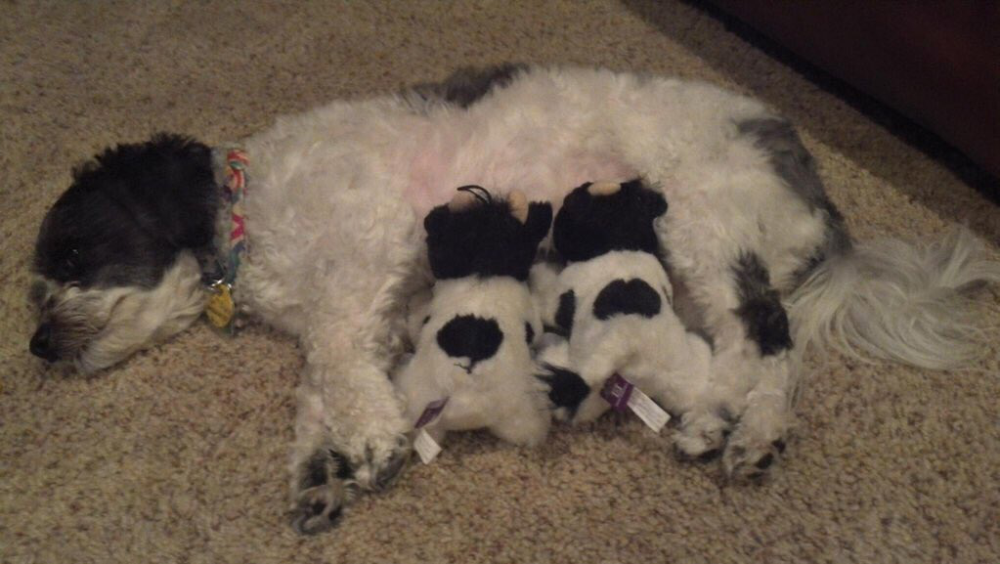

In [591]:
no1_url = df_leasttweets.jpg_url[0]
r = requests.get(no1_url)
Image.open(BytesIO(r.content))

# **2**

In [592]:
df_leasttweets.loc[1,['name', 'retweet_count','dog_stage','p1','favorite_count','rating_numerator']]

name                Scout                 
retweet_count       18                    
dog_stage           NaN                   
p1                  curly-coated_retriever
favorite_count      94                    
rating_numerator    9                     
Name: 1, dtype: object

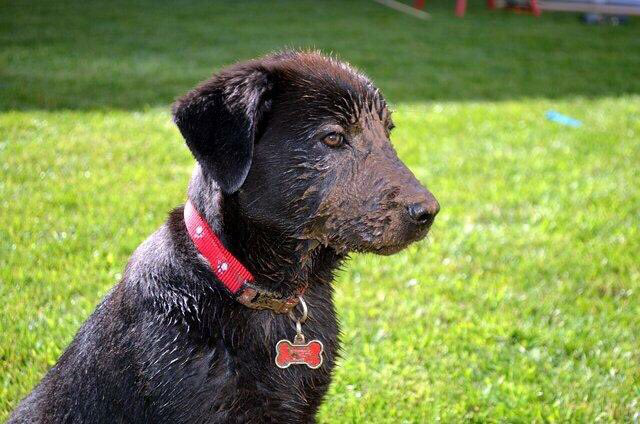

In [593]:
no2_url = df_leasttweets.jpg_url[1]
r = requests.get(no2_url)
Image.open(BytesIO(r.content))

# **3**

In [594]:
df_leasttweets.loc[2,['name', 'retweet_count','dog_stage','p1','favorite_count','rating_numerator']]

name                NaN     
retweet_count       29      
dog_stage           NaN     
p1                  web_site
favorite_count      226     
rating_numerator    10      
Name: 2, dtype: object

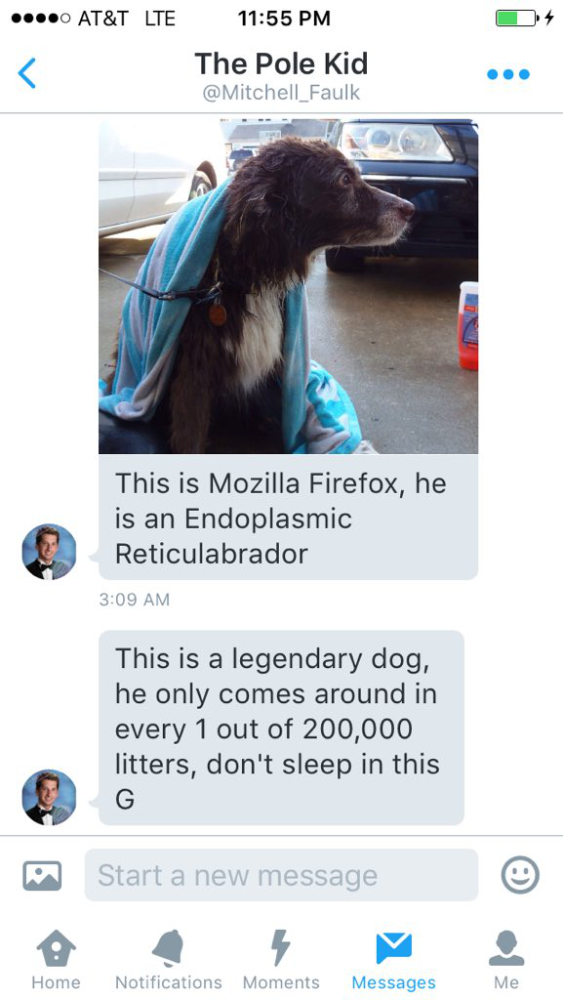

In [595]:
no3_url = df_leasttweets.jpg_url[2]
r = requests.get(no3_url)
Image.open(BytesIO(r.content))

# **4**

In [596]:
df_leasttweets.loc[3,['name', 'retweet_count','dog_stage','p1','favorite_count','rating_numerator']]

name                NaN                    
retweet_count       31                     
dog_stage           NaN                    
p1                  black-and-tan_coonhound
favorite_count      98                     
rating_numerator    7                      
Name: 3, dtype: object

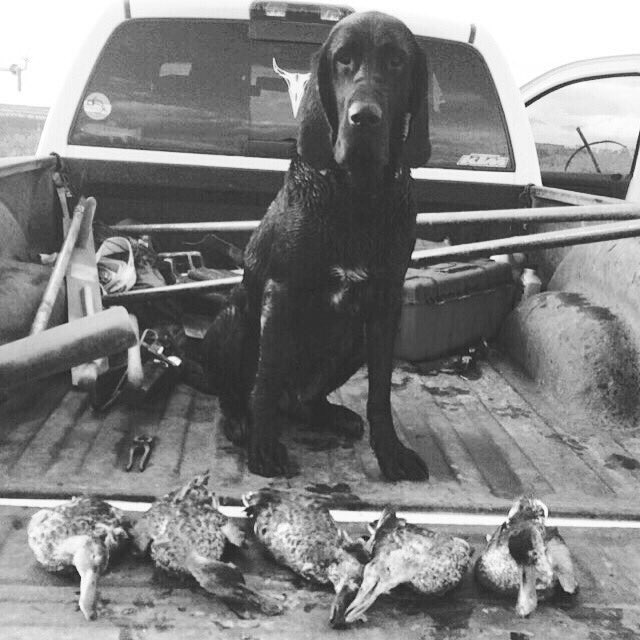

In [597]:
no4_url = df_leasttweets.jpg_url[3]
r = requests.get(no4_url)
Image.open(BytesIO(r.content))

# **5**

In [598]:
df_leasttweets.loc[4,['name', 'retweet_count','dog_stage','p1','favorite_count','rating_numerator']]

name                NaN             
retweet_count       32              
dog_stage           NaN             
p1                  desktop_computer
favorite_count      92              
rating_numerator    10              
Name: 4, dtype: object

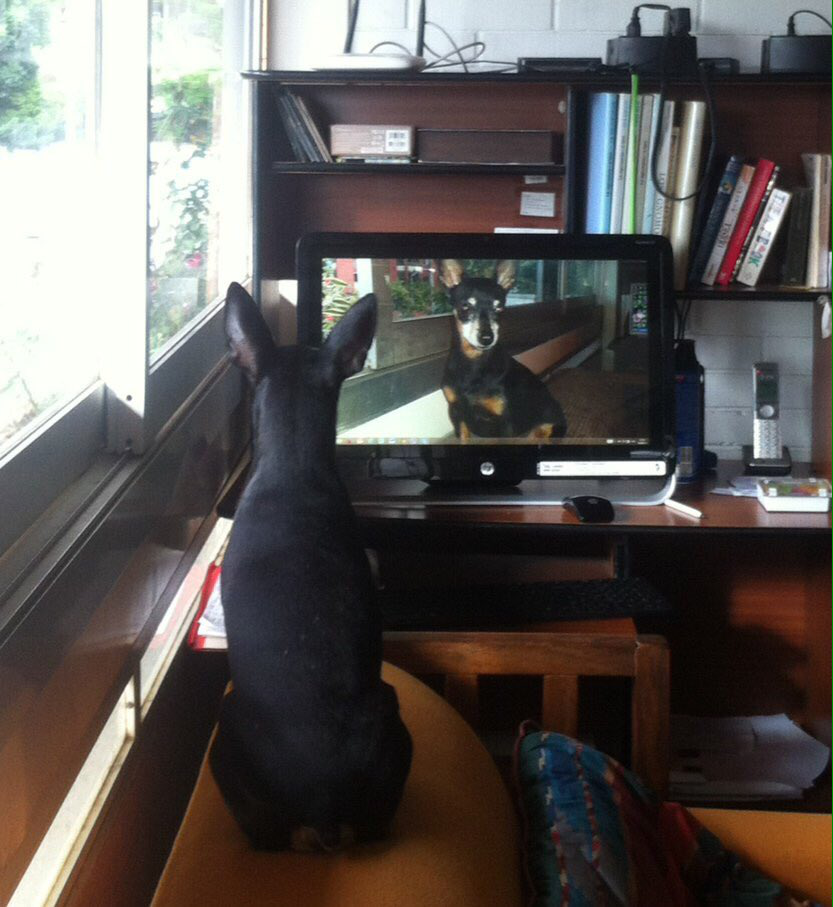

In [599]:
no5_url = df_leasttweets.jpg_url[4]
r = requests.get(no5_url)
Image.open(BytesIO(r.content))

### **Dogs with highest ratings (Top 5)** 

In [600]:
df.rating_numerator.sort_values(ascending=False).head()

916     1776
1729    420 
1012    204 
870     165 
1489    144 
Name: rating_numerator, dtype: int64

In [601]:
ind=df.rating_numerator.sort_values(ascending=False).head().index

In [602]:
# Details of Dogs with most ratings (Tweet Details)
df_highratings = df.loc[np.r_[ind],['rating_numerator','tweet_id','text','name','dog_stage','retweet_count', \
                                              'favorite_count','rating_denominator', 'p1','jpg_url', 'p1_dog']]
df_highratings.reset_index(drop=True, inplace=True)

In [603]:
# Dogs with HIGHEST RATINGS
df_highratings

,rating_numerator,tweet_id,text,name,dog_stage,retweet_count,favorite_count,rating_denominator,p1,jpg_url,p1_dog
0,1776,749981277374128128,This is Atticus. He's quite simply America af. 1776/10,Atticus,NaN,2378.0,4952.0,10,bow_tie,https://pbs.twimg.com/media/CmgBZ7kWcAAlzFD.jpg,False
1,420,670842764863651840,After so many requests... here you go.\n\nGood dogg. 420/10,NaN,NaN,7973.0,22956.0,10,microphone,https://pbs.twimg.com/media/CU9P717W4AAOlKx.jpg,False
2,204,731156023742988288,Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once,NaN,NaN,1211.0,3692.0,170,lakeside,https://pbs.twimg.com/media/CiWWhVNUYAAab_r.jpg,False
3,165,758467244762497024,Why does this never happen at my front door... 165/150,NaN,NaN,2138.0,4662.0,150,Labrador_retriever,https://pbs.twimg.com/ext_tw_video_thumb/758467147756691456/pu/img/YTNzjRFDSPNXukmM.jpg,True
4,144,677716515794329600,IT'S PUPPERGEDDON. Total of 144/120 ...I think,NaN,NaN,922.0,2896.0,120,teddy,https://pbs.twimg.com/media/CWe7kw9W4AE8UJh.jpg,False


<div style="text-align: justify">
    
It is worth noticing from the above table that all the dogs with highest number of ratings also have high retweets and likes and it is expected as ratings are correlated with likes and retweets i.e. if we increase the number of ratings, the number of retweets and likes also increases but it does not imply causation i.e. the increase in likes and retweets is caused by the increase in ratings as there might be an another variable responsible for increase in all of them. Therefore, in order to check whether causation also exists between likes & ratings and retweets & ratings along with correlation, we need to make use of statistical techniques such as Hypothesis Testing or A/B Testing.
</div>

> **`Below all the details such as name, dog stage, dog breed, number of likes, retweets and rating denominator regarding each dog of the top five dogs with highest ratings (rating numerator) are provided`**

# **1**

In [604]:
df_highratings.loc[0,['name','rating_numerator', 'rating_denominator','dog_stage','p1','favorite_count', \
                      'retweet_count']]

name                  Atticus
rating_numerator      1776   
rating_denominator    10     
dog_stage             NaN    
p1                    bow_tie
favorite_count        4952   
retweet_count         2378   
Name: 0, dtype: object

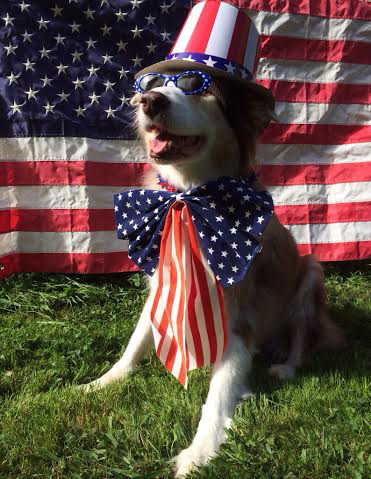

In [605]:
no1_url = df_highratings.jpg_url[0]
r = requests.get(no1_url)
Image.open(BytesIO(r.content))

# **2**

In [606]:
df_highratings.loc[1,['name','rating_numerator', 'rating_denominator','dog_stage','p1','favorite_count', \
                      'retweet_count']]

name                  NaN       
rating_numerator      420       
rating_denominator    10        
dog_stage             NaN       
p1                    microphone
favorite_count        22956     
retweet_count         7973      
Name: 1, dtype: object

```
no2_url = df_highratings.jpg_url[1]
r = requests.get(no2_url)
Image.open(BytesIO(r.content))
```
**`Can not display the image as it may implicate racial discrimination`**

# **3**

In [607]:
df_highratings.loc[2,['name','rating_numerator', 'rating_denominator','dog_stage','p1','favorite_count', \
                      'retweet_count']]

name                  NaN     
rating_numerator      204     
rating_denominator    170     
dog_stage             NaN     
p1                    lakeside
favorite_count        3692    
retweet_count         1211    
Name: 2, dtype: object

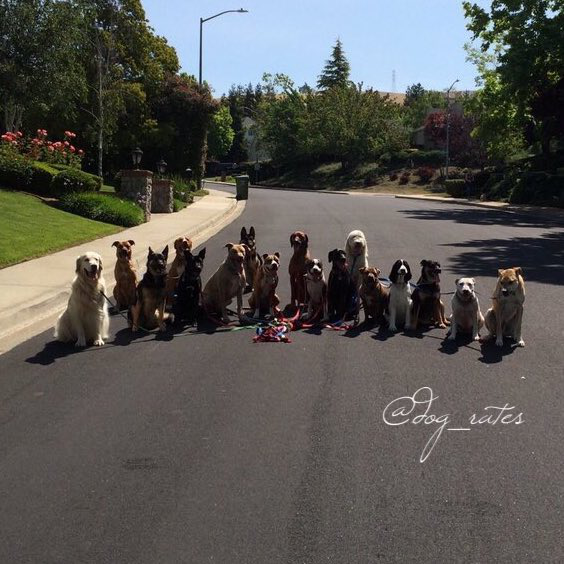

In [608]:
no3_url = df_highratings.jpg_url[2]
r = requests.get(no3_url)
Image.open(BytesIO(r.content))

# **4**

In [609]:
df_highratings.loc[3,['name','rating_numerator', 'rating_denominator','dog_stage','p1','favorite_count', \
                      'retweet_count']]

name                  NaN               
rating_numerator      165               
rating_denominator    150               
dog_stage             NaN               
p1                    Labrador_retriever
favorite_count        4662              
retweet_count         2138              
Name: 3, dtype: object

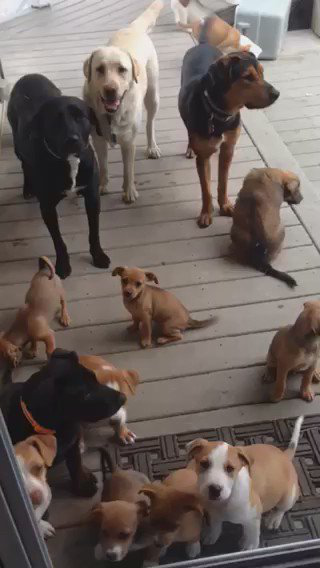

In [610]:
no4_url = df_highratings.jpg_url[3]
r = requests.get(no4_url)
Image.open(BytesIO(r.content))

# **5**

In [611]:
df_highratings.loc[4,['name','rating_numerator', 'rating_denominator','dog_stage','p1','favorite_count', \
                      'retweet_count',]]

name                  NaN  
rating_numerator      144  
rating_denominator    120  
dog_stage             NaN  
p1                    teddy
favorite_count        2896 
retweet_count         922  
Name: 4, dtype: object

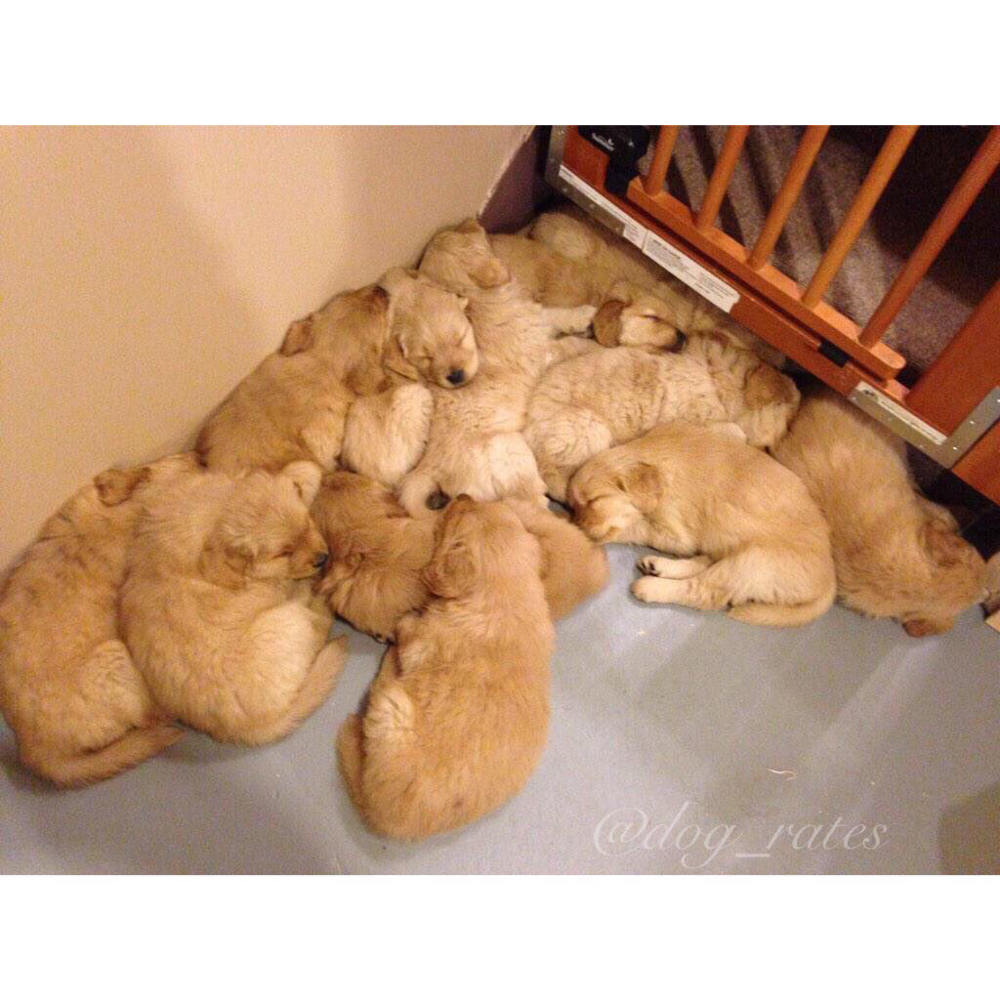

In [612]:
no5_url = df_highratings.jpg_url[4]
r = requests.get(no5_url)
Image.open(BytesIO(r.content))

### **Proportion of predictions which are actually dog breed in mostlikes, highratings and leastretweets groups**

In [613]:
df_isbreed = pd.DataFrame()
df_isbreed['mostlikes'],df_isbreed['highratings'],df_isbreed['leastretweets'] = df_mostlikes.p1_dog, \
                                                                            df_leasttweets.p1_dog, df_highratings.p1_dog

In [614]:
df_isbreed.head()

,mostlikes,highratings,leastretweets
0,True,True,False
1,True,True,False
2,True,False,False
3,True,True,True
4,True,False,False


In [615]:
df_isbreed.describe()

,mostlikes,highratings,leastretweets
count,5,5,5
unique,1,2,2
top,True,True,False
freq,5,3,4


In [616]:
df4 = df_isbreed.describe(include='all')

In [617]:
f1= pd.Series(df4['mostlikes'])
f2= pd.Series(df4['highratings'])
f3= pd.Series(df4['leastretweets'])

In [618]:
li=f1[3]/f1[0]
ra=f2[3]/f2[0]
rt=f3[3]/f3[0]

In [619]:
print('Proportion of predictions which are actually dog breed in mostlikes dataframe is '+str(li))
print('Proportion of predictions which are actually dog breed in highratings dataframe is '+str(ra))
print('Proportion of predictions which are actually dog breed in leastretweets dataframe is '+str(rt))

Proportion of predictions which are actually dog breed in mostlikes dataframe is 1.0
Proportion of predictions which are actually dog breed in highratings dataframe is 0.6
Proportion of predictions which are actually dog breed in leastretweets dataframe is 0.8


<div style="text-align: justify">
    
It is worth noticing that the top five dogs with highest ratings have low proportion of dogs which are actually dog breeds as compared to the top five dogs with least retweets and most likes with dogs having most likes have highest proportion of dogs which are actually dog breeds.
</div>

<a id='References'></a>
## References

- [1.Accessing the elements of df.describe()](https://discuss.analyticsvidhya.com/t/how-can-we-access-the-elements-of-df-describe-for-any-dataframe-df/1107)
- [2.How to use matplotlib autopct](https://stackoverflow.com/questions/6170246/how-do-i-use-matplotlib-autopct)
- [3.Reading and writing json data to a file](https://stackabuse.com/reading-and-writing-json-to-a-file-in-python/)
- [4.Python Regular Expressions](https://www.tutorialspoint.com/python/python_reg_expressions.htm)
- [5.How to show null values using value_counts() function](https://stackoverflow.com/questions/38953532/why-does-value-counts-not-show-all-values-present)
- [6.Wide to long functions in python](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.wide_to_long.html)